This notebooks purpose is to take images you have generated from your GAN and perform clustering via VGG16 model to cluster similar images together from their feature vectors.
This assumes you have generated images already.

In [ ]:
# Mount G-Drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

MessageError: ignored

In [ ]:
import pickle

In [ ]:
parent_dir = "/content/drive/MyDrive/data/gan"

In [ ]:
a_file = open(parent_dir + '/clusteringdata.pkl', "rb")
output = pickle.load(a_file)
print(output[0])

[array(['seed24698.png/seed24699.png',
       '1477faff5b02239597f9172f64aecfa7_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed23522.png/seed23523.png',
       'cfcf069691973555073dd8bb0d189cd4_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed22132.png/seed22133.png',
       '14e57383c9a58e8c613055efca16d95b_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed22303.png/seed22304.png',
       '7680a785f76835b5632973d6019de633_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed18072.png/seed18073.png',
       'd6de9119cf9e290bf1d9e5a93f7fdfa7_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed8376.png/seed8377.png',
       'aeedf6e5cde81fdd508c4c71371ce75a_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed7502.png/seed7503.png',
       '9ee43ba9b2471938fd2e8757babdfcf9_pokemon_digimon_gan.png'],
      dtype='<U56'), array(['seed0573.png/seed0574.png',
       '737ba0351537a457470f8cd5f90684d6_pokemon_digimon_gan.png'],
      dtyp

In [ ]:
groups = output

In [ ]:
len_groups = 900

In [ ]:
import glob

In [ ]:
import shutil

In [ ]:
from PIL import Image

In [ ]:
# for loading/processing the images  
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

As the amount of images was extremely large, this was only taking care to separate the images between clusters 136 to 449.

In [ ]:
#try:
#  shutil.rmtree(parent_dir + "/clustered_images/")
#except:
#  print("no folders")

#try:
#  shutil.rmtree(parent_dir + "/clustered_images/671")
#except:
#  print("no folders")



for group_number in range(136, 449):
  directory = parent_dir + "/voxmon_images/" + str(group_number)
  os.makedirs(directory)
  for image in groups[group_number]:
    try:
      img = load_img(parent_dir + "/" + image[0], target_size=(1024,1024))
      img = img.save(f"{directory}/" + str(image[1]))
    except:
      try:
        img = load_img(parent_dir + "/" + "output_images/" + os.path.split(image[0])[1], target_size=(1024,1024))
        img = img.save(f"{directory}/" + str(image[1]))
      except:
        print("image failed")

In [ ]:
import os

In [ ]:
aa

Next, clone StyleGAN2 ADA PyTorch from GitHub.

In [ ]:
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
!pip install ninja

Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 128, done.
remote: Total 128 (delta 0), reused 0 (delta 0), pack-reused 128
Receiving objects: 100% (128/128), 1.12 MiB | 23.90 MiB/s, done.
Resolving deltas: 100% (58/58), done.
     |████████████████████████████████| 108 kB 14.7 MB/s 


Verify that StyleGAN has been cloned.

In [ ]:
!ls /content/stylegan2-ada-pytorch/

calc_metrics.py  docker_run.sh	LICENSE.txt   style_mixing.py
dataset_tool.py  docs		metrics       torch_utils
dnnlib		 generate.py	projector.py  training
Dockerfile	 legacy.py	README.md     train.py


In [ ]:
!pip3 install keras

In [ ]:
# for loading/processing the images  
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

The following code will move between the provided seeds.  The constant STEPS specify how many frames there should be between each of the seeds.

In [ ]:
import os

In [ ]:
from PIL import Image

In [ ]:
import hashlib

In [ ]:
def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

In [ ]:
os.path.split(path0)[-1]

'output_images_nov_30'

In [ ]:
path0 = "/content/drive/MyDrive/data/gan/output_images"

In [ ]:
data = {}
p = "/content/drive/MyDrive/data/gan/vgg_vectors"

In [ ]:
## test image
path0 = "/content/drive/MyDrive/data/gan/output_images" #pokemon gan
# change the working directory to the path where the images are located
# this list holds all the image filename
flowers = []

# initiating the model
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)
os.chdir(path0)

# creates a ScandirIterator aliased as files
with os.scandir(path0) as files:
  # loops through each file in the directory
    for file in files:
      if file.name.endswith('.png'):
        md5hash = hashlib.md5(Image.open(file.name).tobytes())
        #print(md5hash.hexdigest())
        # adds only the image files to the flowers list
        #hex_representation = imagehash.average_hash(Image.open(file.name))

        flowers.append(str(md5hash.hexdigest()) + "_generated_gan.png")
        
        # try to extract the features and update the dictionary
        try:
            feat = extract_features(file.name,model)
            path1 = os.path.split(path0)[-1] + "/" + file.name
            data[path1, str(md5hash.hexdigest())+ "_generated_gan.png"] = feat
        # if something fails, save the extracted features as a pickle file (optional)
        except:
            with open(p,'wb') as file:
                pickle.dump(data,file)

path1 = "/content/drive/MyDrive/data/gan/output_images" #dig. gan
os.chdir(path1)
# creates a ScandirIterator aliased as files
with os.scandir(path1) as files:
  # loops through each file in the directory
    for file in files:
      if file.name.endswith('.png'):
        md5hash = hashlib.md5(Image.open(file.name).tobytes())
        #print(md5hash.hexdigest())
        # adds only the image files to the flowers list
        #hex_representation = imagehash.average_hash(Image.open(file.name))

        flowers.append(str(md5hash.hexdigest()) + "gan_features_1.png")
        
        # try to extract the features and update the dictionary
        try:
            feat = extract_features(file.name,model)
            path1 = os.path.split(path1)[-1] + "/" + file.name
            data[path1, str(md5hash.hexdigest())+ "gan_features_1.png"] = feat
        # if something fails, save the extracted features as a pickle file (optional)
        except:
            with open(p,'wb') as file:
                pickle.dump(data,file)

path2 = "/content/drive/MyDrive/data/gan/output_images" #rud. gan
os.chdir(path2)
# creates a ScandirIterator aliased as files
with os.scandir(path2) as files:
  # loops through each file in the directory
    for file in files:
      if file.name.endswith('.png'):
        md5hash = hashlib.md5(Image.open(file.name).tobytes())
        #print(md5hash.hexdigest())
        # adds only the image files to the flowers list
        #hex_representation = imagehash.average_hash(Image.open(file.name))

        flowers.append(str(md5hash.hexdigest()) + "gan_features_2.png")
        
        # try to extract the features and update the dictionary
        try:
            feat = extract_features(file.name,model)
            path1 = os.path.split(path2)[-1] + "/" + file.name
            data[path1, str(md5hash.hexdigest())+ "gan_features_2.png"] = feat
        # if something fails, save the extracted features as a pickle file (optional)
        except:
            with open(p,'wb') as file:
                pickle.dump(data,file)

path3 = "/content/drive/MyDrive/data/gan/gan_features_2" #rud. gan
os.chdir(path3)
# creates a ScandirIterator aliased as files
with os.scandir(path3) as files:
  # loops through each file in the directory
    for file in files:
      if file.name.endswith('.png'):
        md5hash = hashlib.md5(Image.open(file.name).tobytes())
        #print(md5hash.hexdigest())
        # adds only the image files to the flowers list
        #hex_representation = imagehash.average_hash(Image.open(file.name))

        flowers.append(str(md5hash.hexdigest()) + "gan_features_2.png")
        
        # try to extract the features and update the dictionary
        try:
            feat = extract_features(file.name,model)
            path1 = os.path.split(path3)[-1] + "/" + file.name
            data[path1, str(md5hash.hexdigest())+ "gan_features_2.png"] = feat
        # if something fails, save the extracted features as a pickle file (optional)
        except:
            with open(p,'wb') as file:
                pickle.dump(data,file)


#path0 = "/content/drive/MyDrive/data/gan/output_images_nov_30" #pokemon gan
#path1 = "/content/drive/MyDrive/data/gan/output_images_nov_25" #pokemon + dig. gan
#path2 = "/content/drive/MyDrive/data/gan/output_images_jan_24" #rud. gan
#path3 = "/content/drive/MyDrive/data/gan/pokemon_jan_20" #pokemon rud.

553476096/553467096 [==============================] - 4s 0us/step


In [ ]:
path3 = "/content/drive/MyDrive/data/gan/gan_features_2" #rud. gan
os.chdir(path3)
# creates a ScandirIterator aliased as files
with os.scandir(path3) as files:
  # loops through each file in the directory
    for file in files:
      if file.name.endswith('.png'):
        md5hash = hashlib.md5(Image.open(file.name).tobytes())
        #print(md5hash.hexdigest())
        # adds only the image files to the flowers list
        #hex_representation = imagehash.average_hash(Image.open(file.name))

        flowers.append(str(md5hash.hexdigest()) + "gan_features_2.png")
        
        # try to extract the features and update the dictionary
        try:
            feat = extract_features(file.name,model)
            path1 = os.path.split(path3)[-1] + "/" + file.name
            data[path1, str(md5hash.hexdigest())+ "gan_features_2.png"] = feat
        # if something fails, save the extracted features as a pickle file (optional)
        except:
            with open(p,'wb') as file:
                pickle.dump(data,file)

In [ ]:
len(flowers)

98928

In [ ]:
len(set(flowers))

98928

In [ ]:
path0 = "/content/drive/MyDrive/data/gan/output_images_nov_30" #pokemon gan
path1 = "/content/drive/MyDrive/data/gan/output_images_nov_25" #pokemon + dig. gan
path2 = "/content/drive/MyDrive/data/gan/output_images_jan_24" #rud. gan
path3 = "/content/drive/MyDrive/data/gan/pokemon_jan_20" #pokemon rud.
# change the working directory to the path where the images are located
os.chdir(path)

# this list holds all the image filename
flowers = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.png'):
          # adds only the image files to the flowers list
          print(file.name)
          flowers.append(file.name)
            
            
            
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features
   
data = {}
p = "/content/drive/MyDrive/data/gan/vgg_vectors"

# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          
 
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

Streaming output truncated to the last 5000 lines.
seed4003.png
seed4004.png
seed4005.png
seed4006.png
seed4007.png
seed4008.png
seed4009.png
seed4010.png
seed4011.png
seed4012.png
seed4013.png
seed4014.png
seed4015.png
seed4016.png
seed4017.png
seed4018.png
seed4019.png
seed4020.png
seed4021.png
seed4022.png
seed4023.png
seed4024.png
seed4025.png
seed4026.png
seed4027.png
seed4028.png
seed4029.png
seed4030.png
seed4031.png
seed4032.png
seed4033.png
seed4034.png
seed4035.png
seed4036.png
seed4037.png
seed4038.png
seed4039.png
seed4040.png
seed4041.png
seed4042.png
seed4043.png
seed4044.png
seed4045.png
seed4046.png
seed4047.png
seed4048.png
seed4049.png
seed4050.png
seed4051.png
seed4052.png
seed4053.png
seed4054.png
seed4055.png
seed4056.png
seed4057.png
seed4058.png
seed4059.png
seed4060.png
seed4061.png
seed4062.png
seed4063.png
seed4064.png
seed4065.png
seed4066.png
seed4067.png
seed4068.png
seed4069.png
seed4070.png
seed4071.png
seed4072.png
seed4073.png
seed4074.png
seed4075.png


In [ ]:
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

In [ ]:
len(feat)

98928

In [ ]:
# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)

# reduce the amount of dimensions in the feature vector
pca = PCA(n_components=100, random_state=22)
pca.fit(feat)
x = pca.transform(feat)

# cluster feature vectors
kmeans = KMeans(n_clusters=900, random_state=22)
kmeans.fit(x)

# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
  if cluster not in groups.keys():
      groups[cluster] = []
      groups[cluster].append(file)
  else:
      groups[cluster].append(file)

# function that lets you view a cluster (based on identifier)        
#def view_cluster(cluster):
#    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
#    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
#    if len(files) > 30:
#        print(f"Clipping cluster size from {len(files)} to 30")
#        files = files[:29]
    # plot each image in the cluster
#    for index, file in enumerate(files):
#        plt.subplot(10,10,index+1);
#        img = load_img(file)
#        img = np.array(img)
#        plt.imshow(img)
#        plt.axis('off')
        
   
# this is just incase you want to see which value for k might be the best 
#sse = []
#list_k = list(range(3, 150))

#for k in list_k:
#    km = KMeans(n_clusters=k, random_state=22 )
#    km.fit(x)
    
#    sse.append(km.inertia_)

# Plot sse against k
#plt.figure(figsize=(6, 6))
#plt.plot(list_k, sse)
#plt.xlabel(r'Number of clusters *k*')
#plt.ylabel('Sum of squared distance');

## 1) go through each group, create a folder inside the main folder
## 2) for each image in each group, save into the folder
## 3) continue

In [ ]:
len(groups)

900

In [ ]:
len_groups = len(groups)

In [ ]:
parent_dir = "/content/drive/MyDrive/data/gan"

In [ ]:
import glob

In [ ]:
import shutil

In [ ]:
## Saving the output images

In [ ]:
"output_images/" + os.path.split('seed20797.png/seed20798.png')[1]

'output_images_nov_25/seed20798.png'

In [ ]:
groups[0]

[array(['output_images_nov_30/seed8460.png',
        '80897d7e4ebab8dcf2e38073585c8a14_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed7982.png',
        'becbd2406b6c39bbbf53f355daf951d6_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed6257.png',
        'c17485f395ac1ca54ab4d7bcf03b8dab_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed5036.png',
        '8625e0bd2f2e771fc3e67096fadd3829_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed5184.png',
        '7f942cbf8de96fcbd59649f9f3a17105_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed5277.png',
        'e9f801ed623abcae52594830d7a9cba1_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed5528.png',
        '25ec85e8a665eb8cd1fb16d7217d7522_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/seed4865.png',
        '5bf6ab204140241c6ed00614edccf814_pokemon_gan.png'], dtype='<U56'),
 array(['output_images_nov_30/se

In [ ]:
len_groups

900

In [ ]:
a_file = open(parent_dir + '/clusteringdata.pkl', "wb")
pickle.dump(groups, a_file)
a_file.close()

In [ ]:
parent_dir + "/clusteringdata.pkl"

'/content/drive/MyDrive/data/gan/clusteringdata_jan28.pkl'

In [ ]:
groups

{0: [array(['seed24698.png/seed24699.png',
         '1477faff5b02239597f9172f64aecfa7_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed23522.png/seed23523.png',
         'cfcf069691973555073dd8bb0d189cd4_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed22132.png/seed22133.png',
         '14e57383c9a58e8c613055efca16d95b_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed22303.png/seed22304.png',
         '7680a785f76835b5632973d6019de633_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed18072.png/seed18073.png',
         'd6de9119cf9e290bf1d9e5a93f7fdfa7_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed8376.png/seed8377.png',
         'aeedf6e5cde81fdd508c4c71371ce75a_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed7502.png/seed7503.png',
         '9ee43ba9b2471938fd2e8757babdfcf9_pokemon_digimon_gan.png'],
        dtype='<U56'), array(['seed0573.png/seed0574.png',
         '737ba0351537a457470f8cd5f90684d6_pok

In [ ]:
try:
  shutil.rmtree(parent_dir + "/clustered_images/")
except:
  print("no folders")

for group_number in range(len_groups):
  directory = parent_dir + "/clustered_images/" + str(group_number)
  os.makedirs(directory)
  for image in groups[group_number]:
    try:
      img = load_img(parent_dir + "/" + image[0], target_size=(100,100))
      img = img.save(f"{directory}/" + str(image[1]))
    except:
      img = load_img(parent_dir + "/" + "output_images/" + os.path.split(image[0])[1], target_size=(100,100))
      img = img.save(f"{directory}/" + str(image[1]))

KeyboardInterrupt: ignored

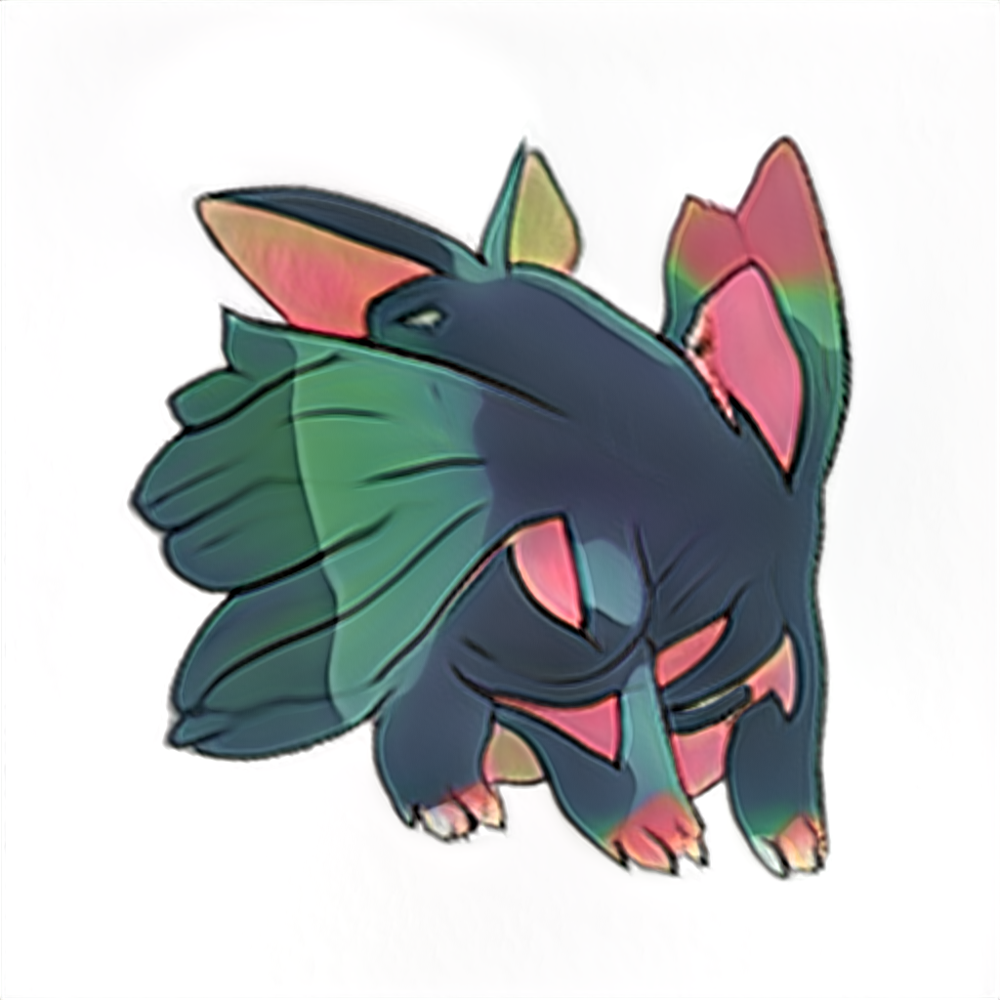

seed9005.png


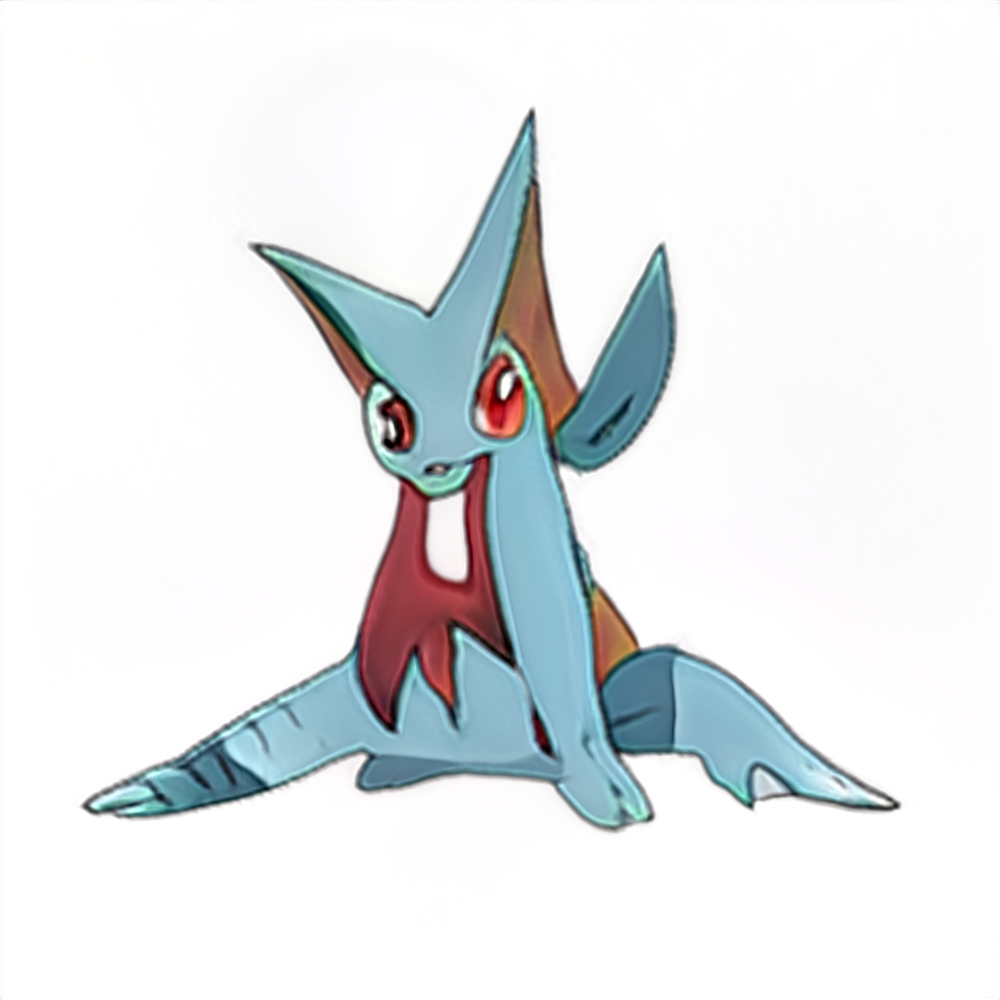

seed9007.png


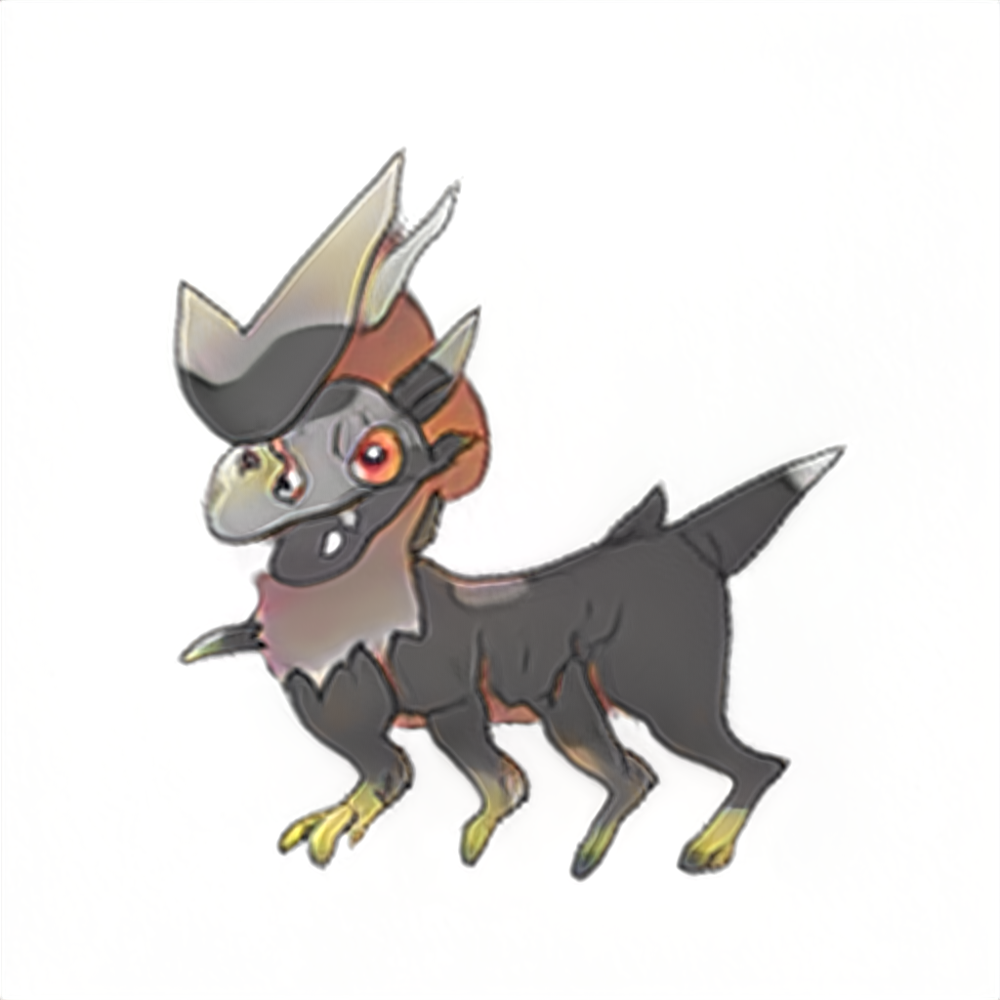

seed9019.png


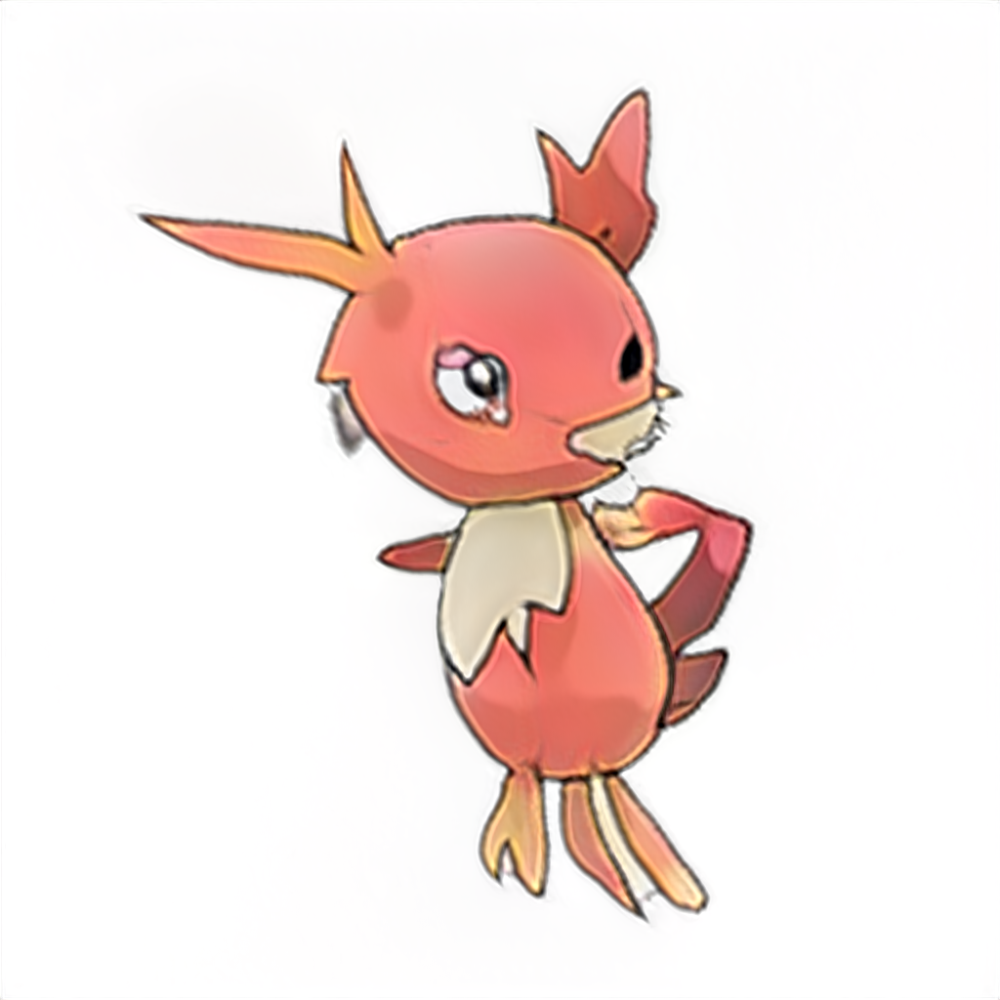

seed9046.png


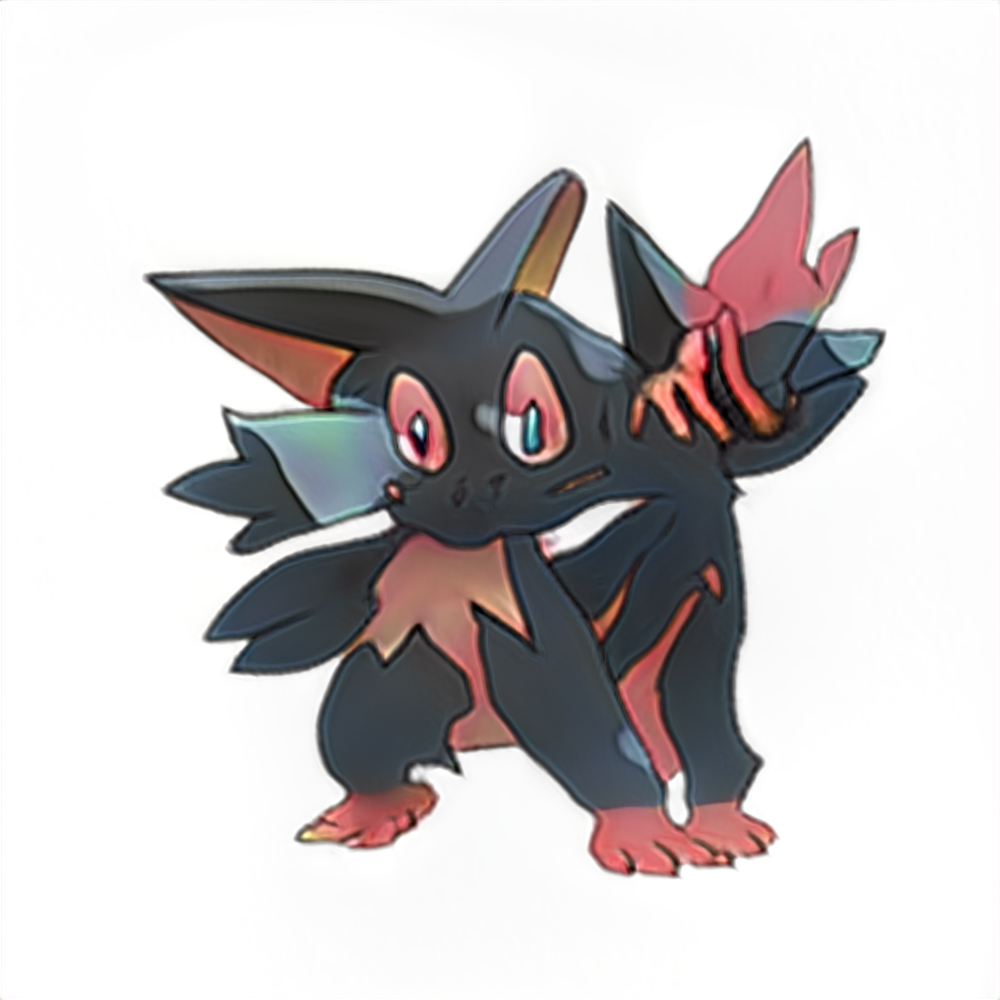

seed9163.png


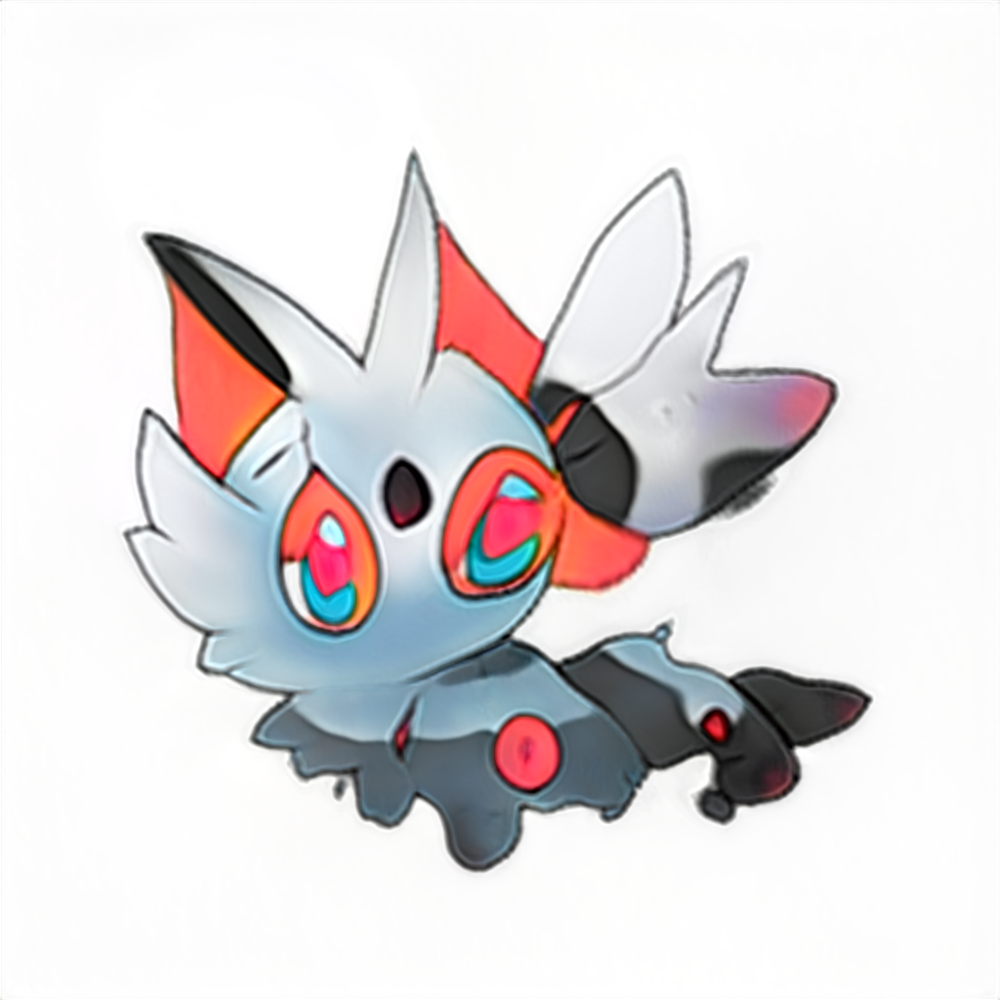

seed9201.png


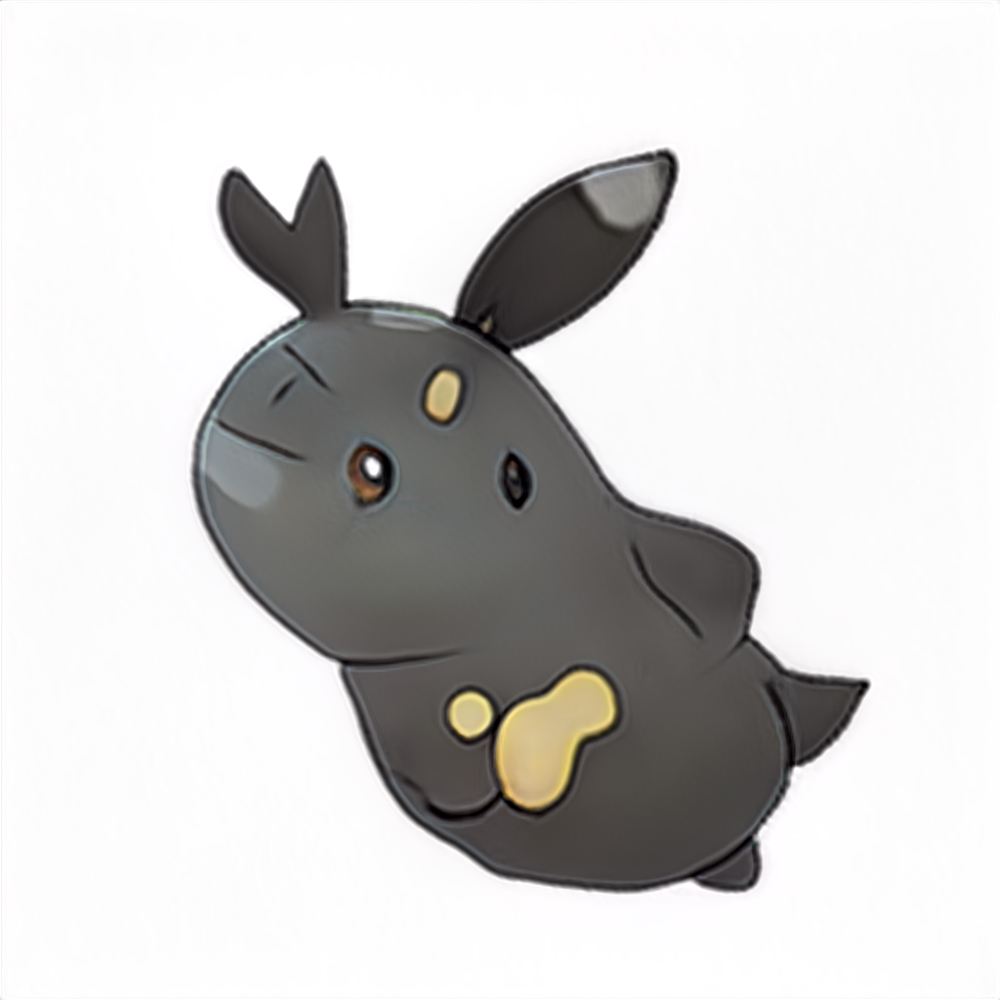

seed9205.png


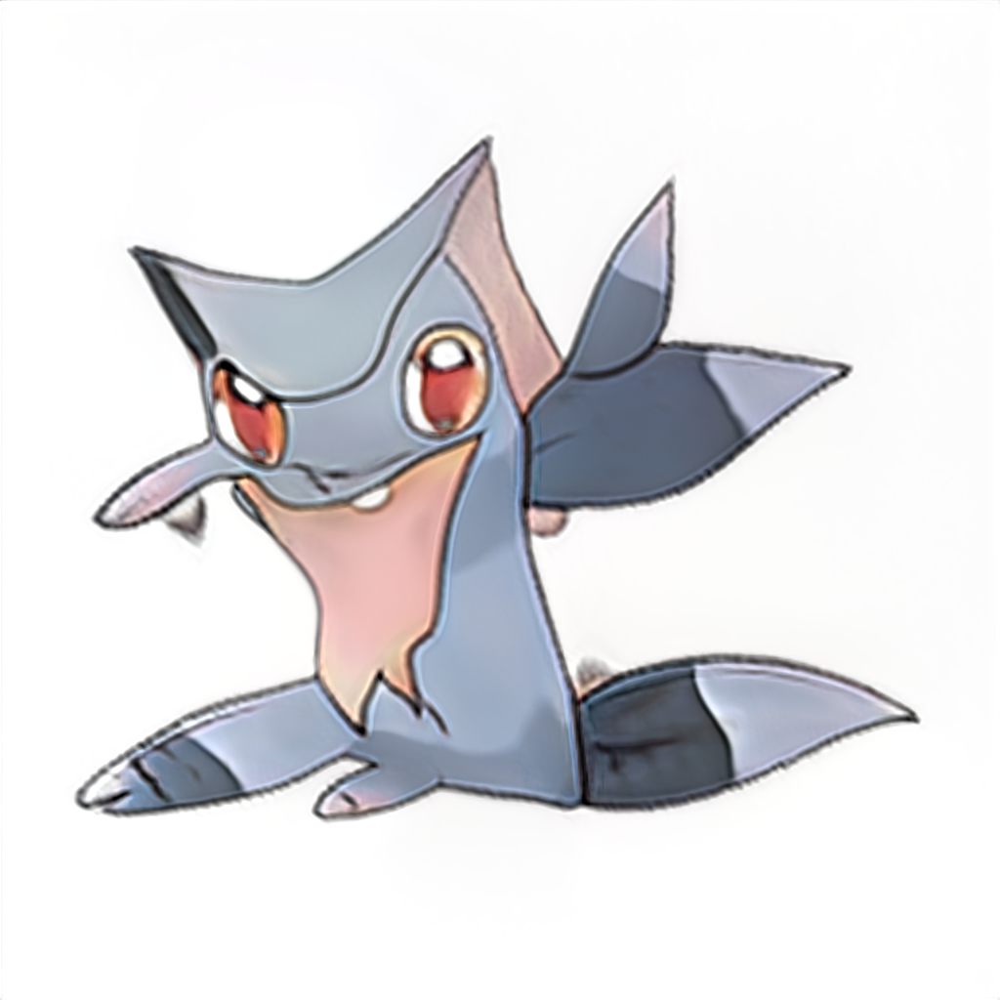

seed9243.png


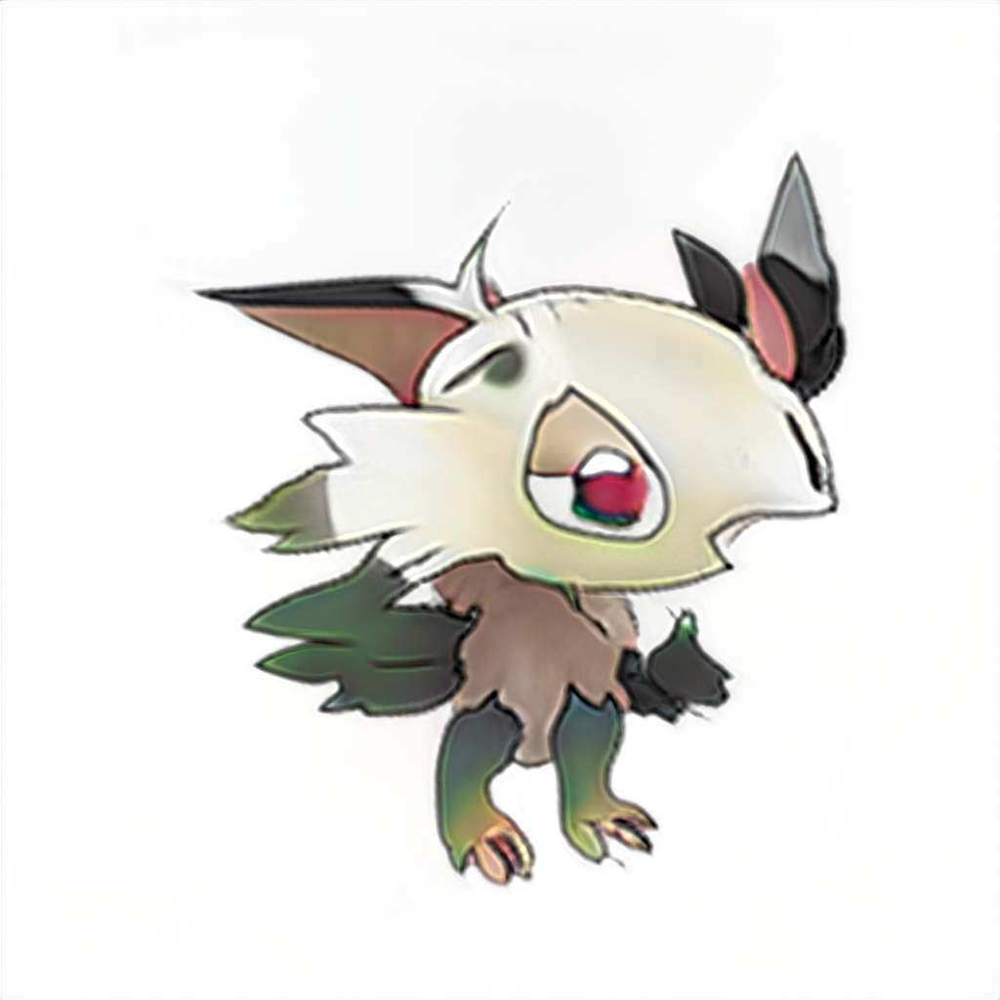

seed9248.png


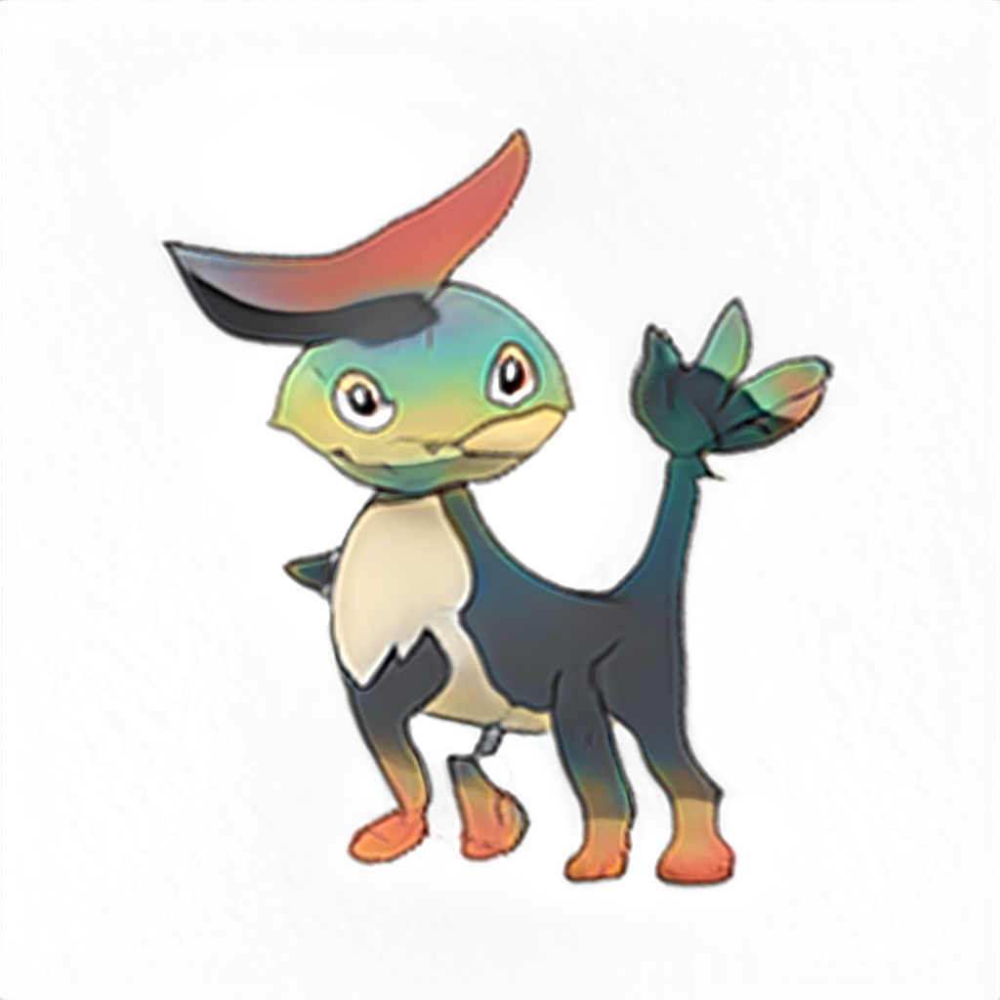

seed9258.png


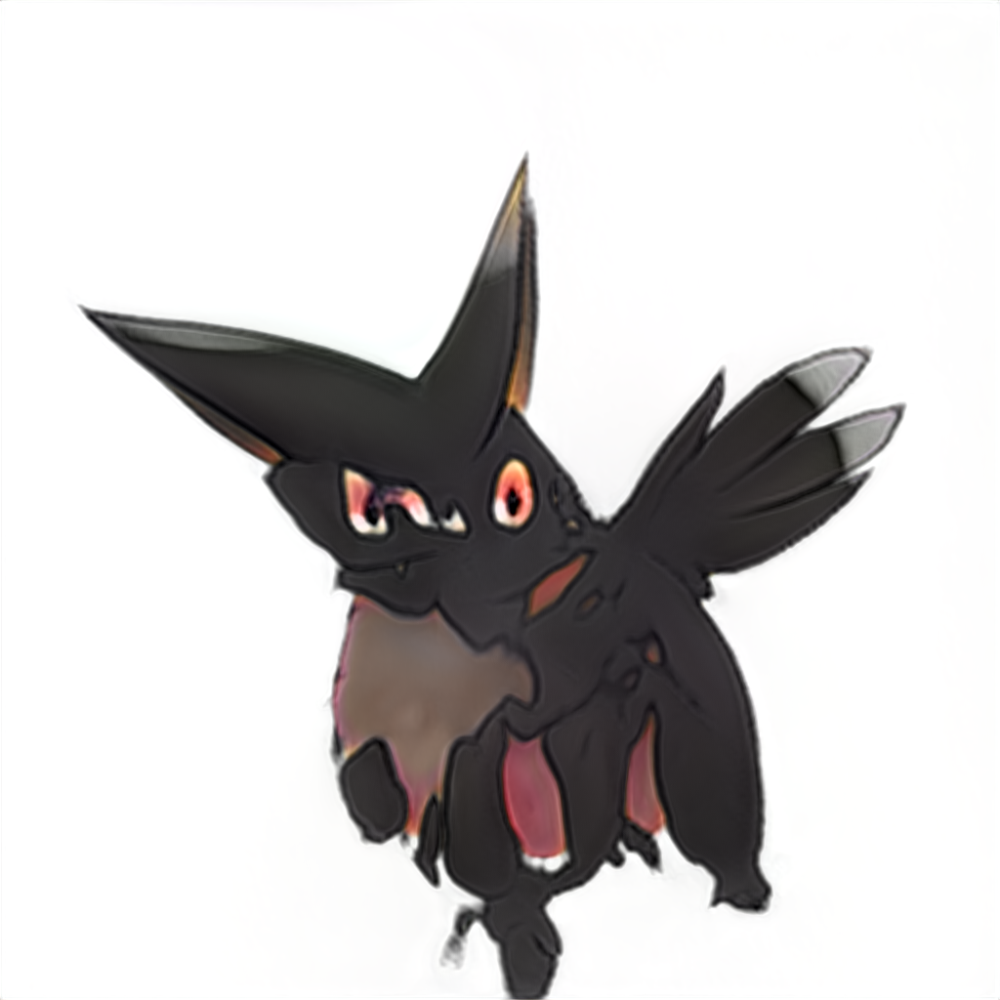

seed9259.png


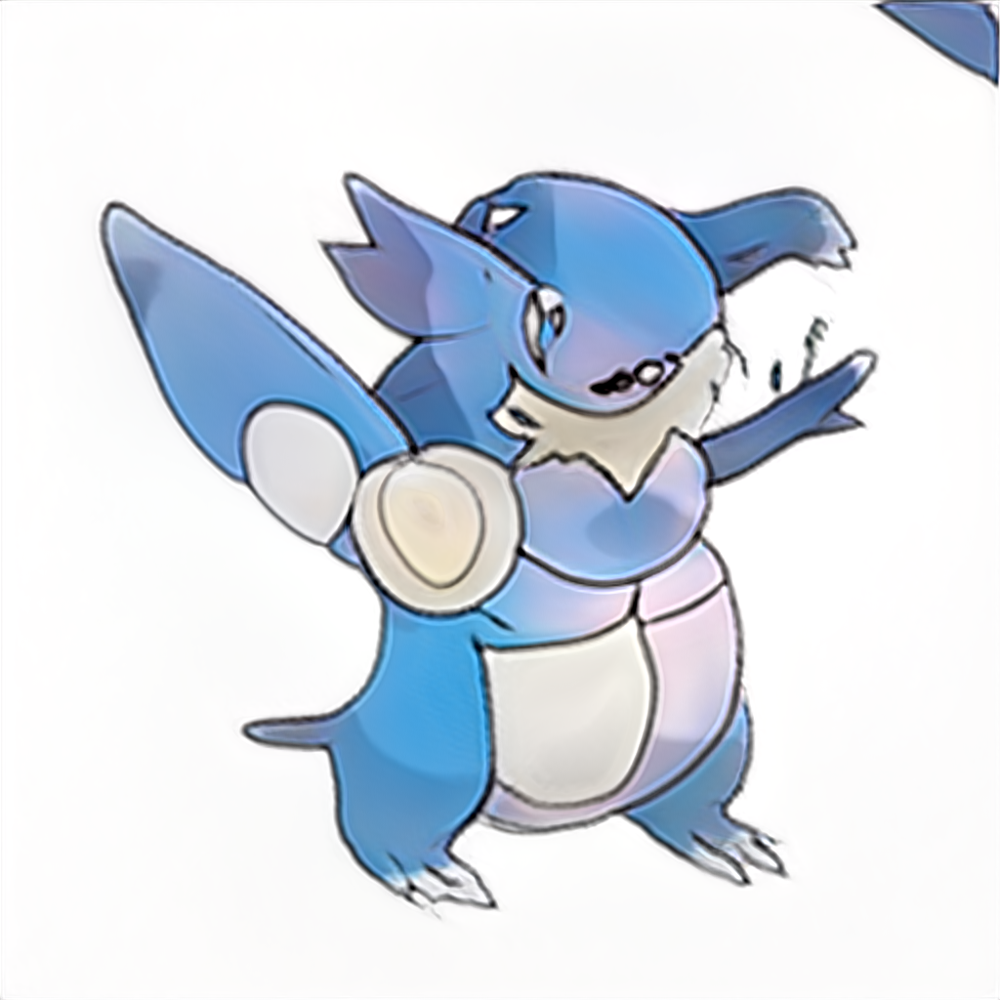

seed9263.png


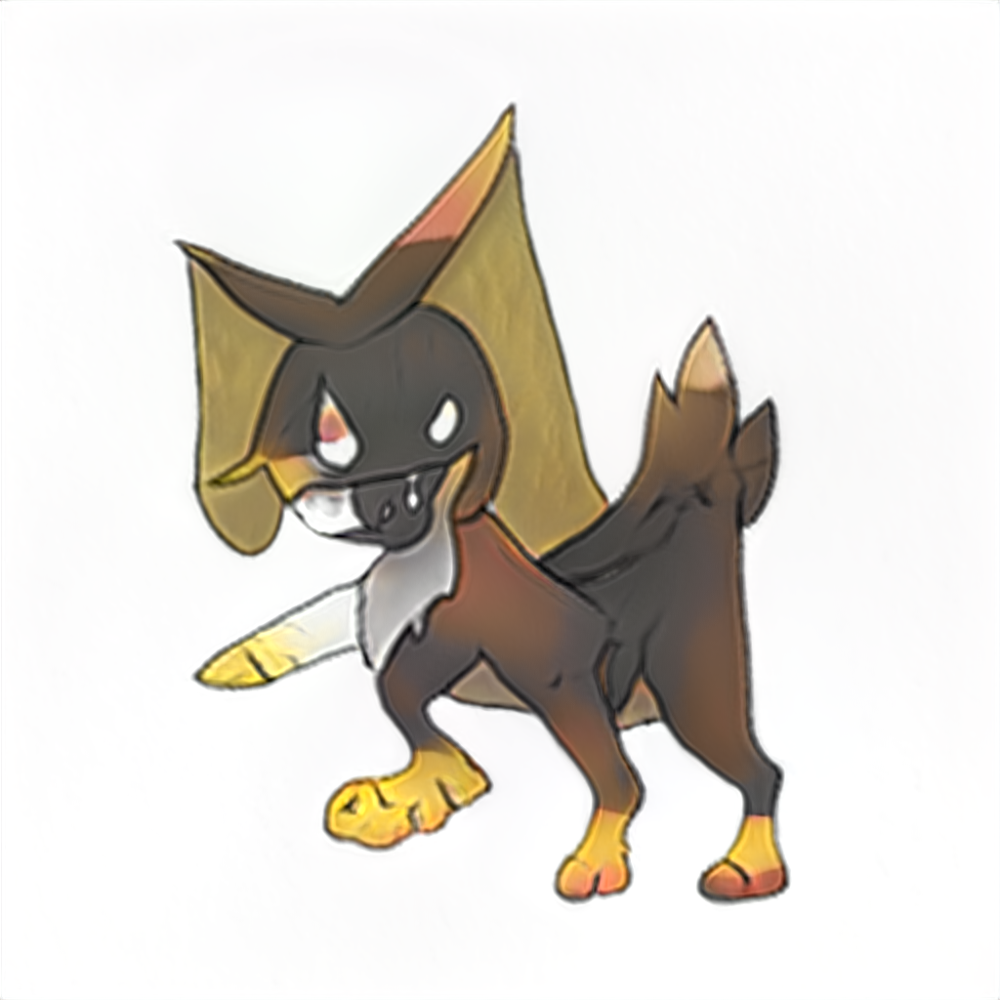

seed9282.png


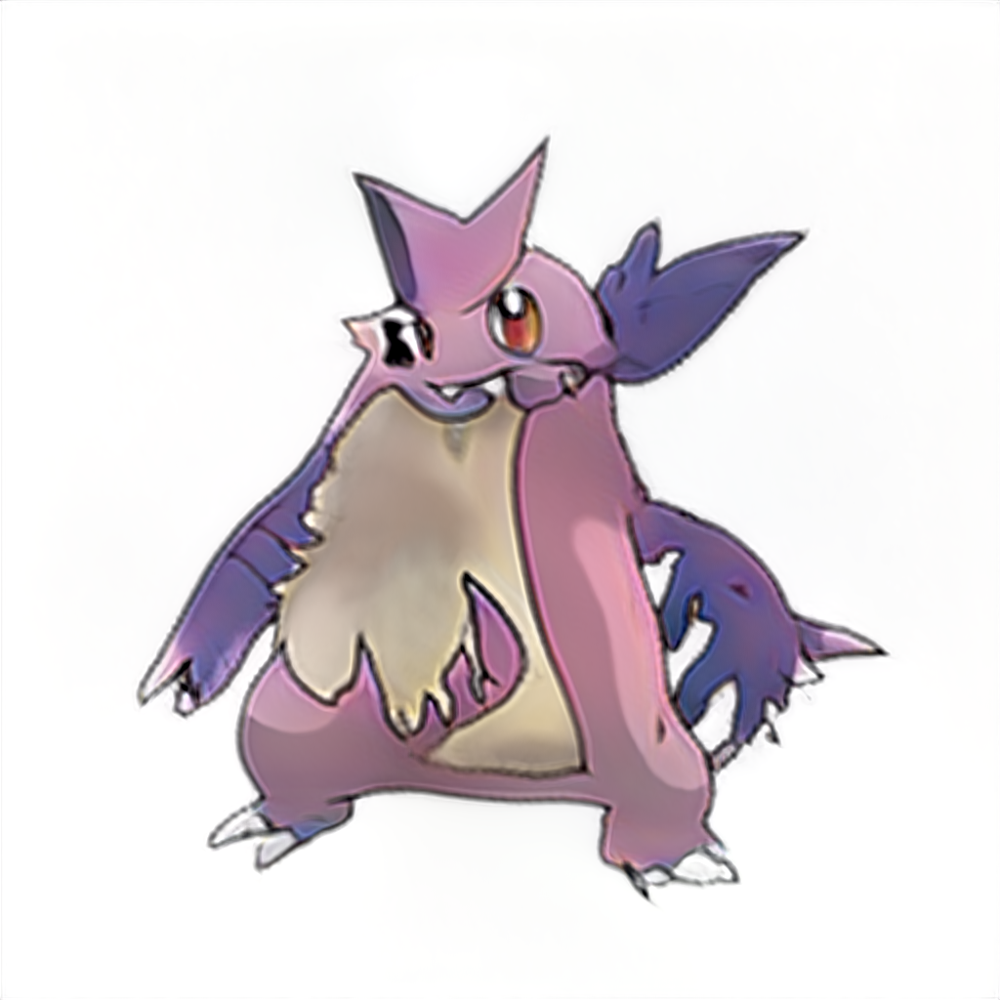

seed9390.png


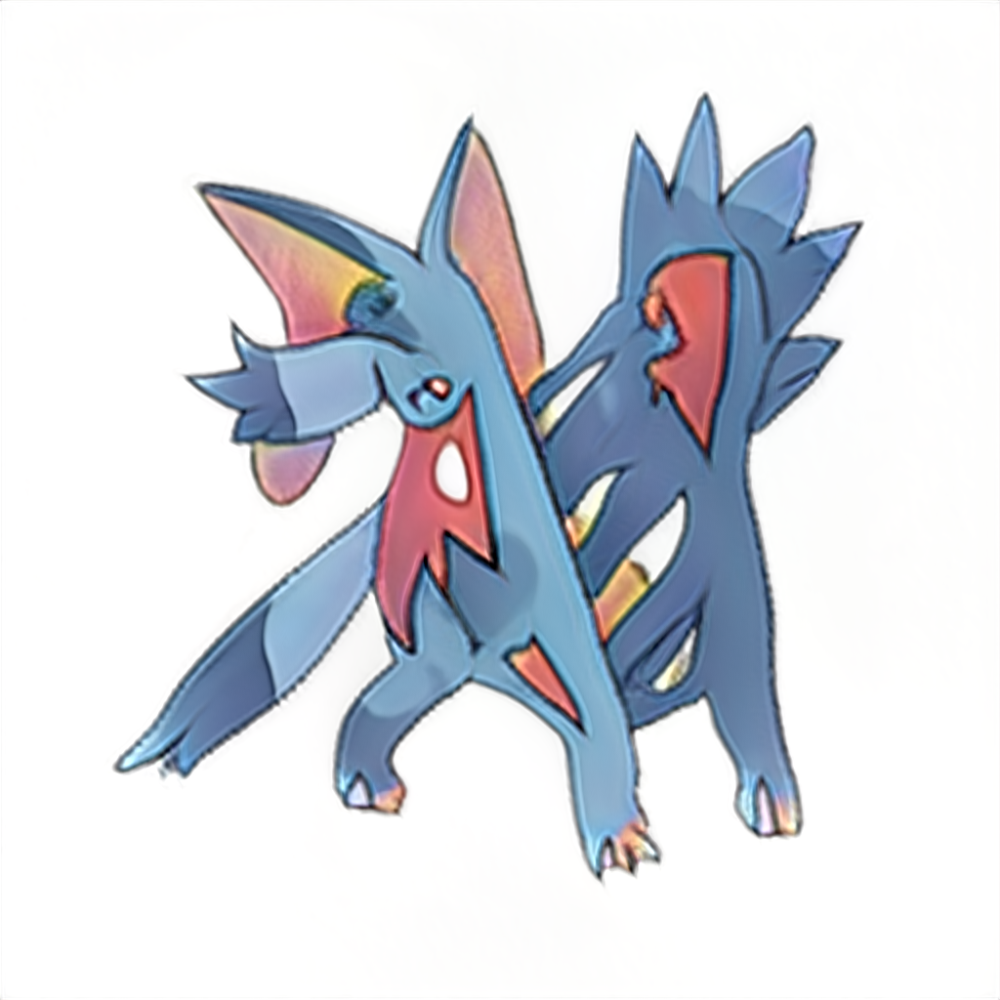

seed9399.png


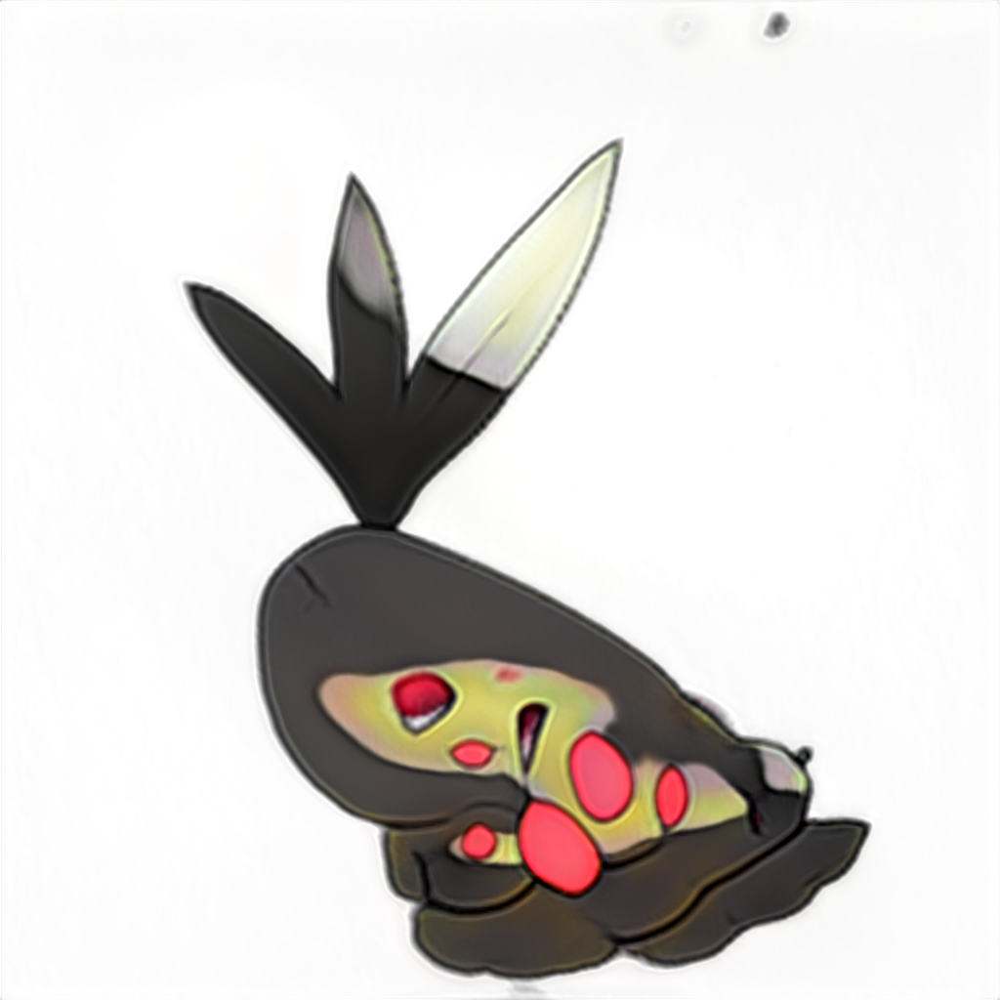

seed9402.png


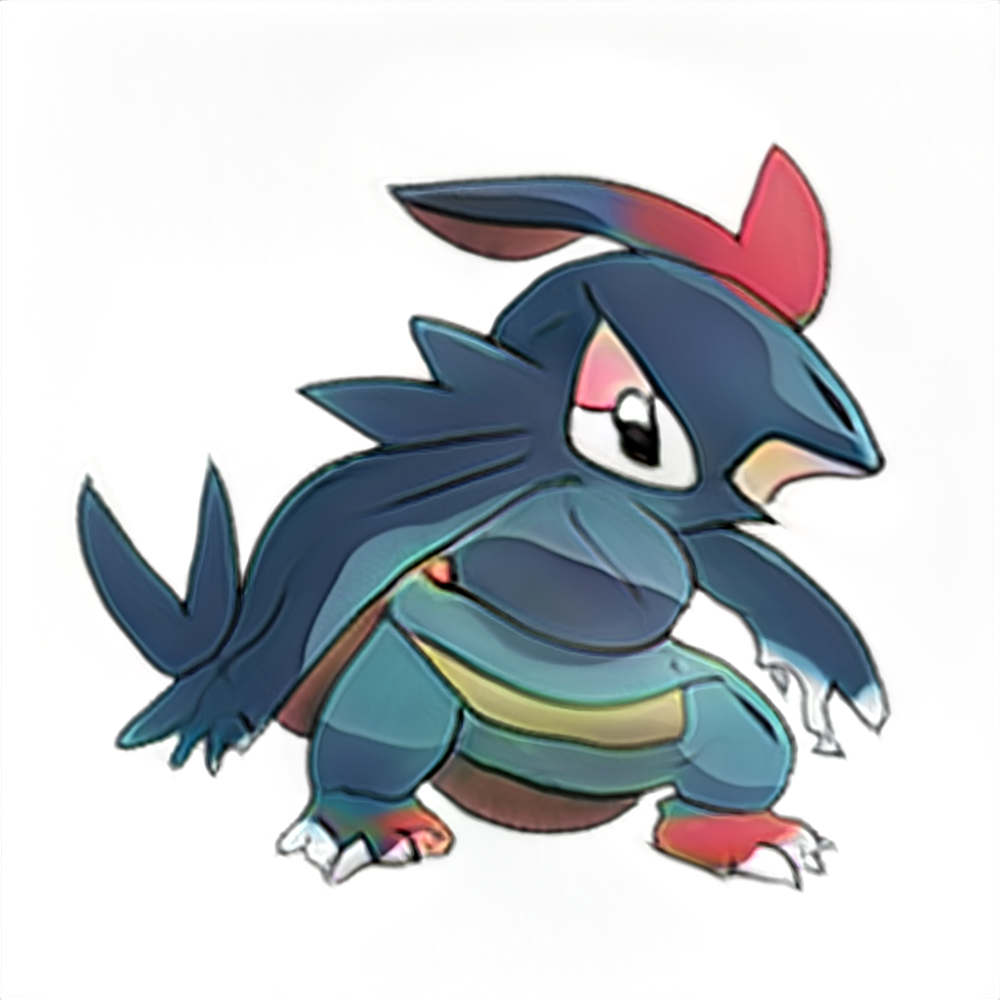

seed9424.png


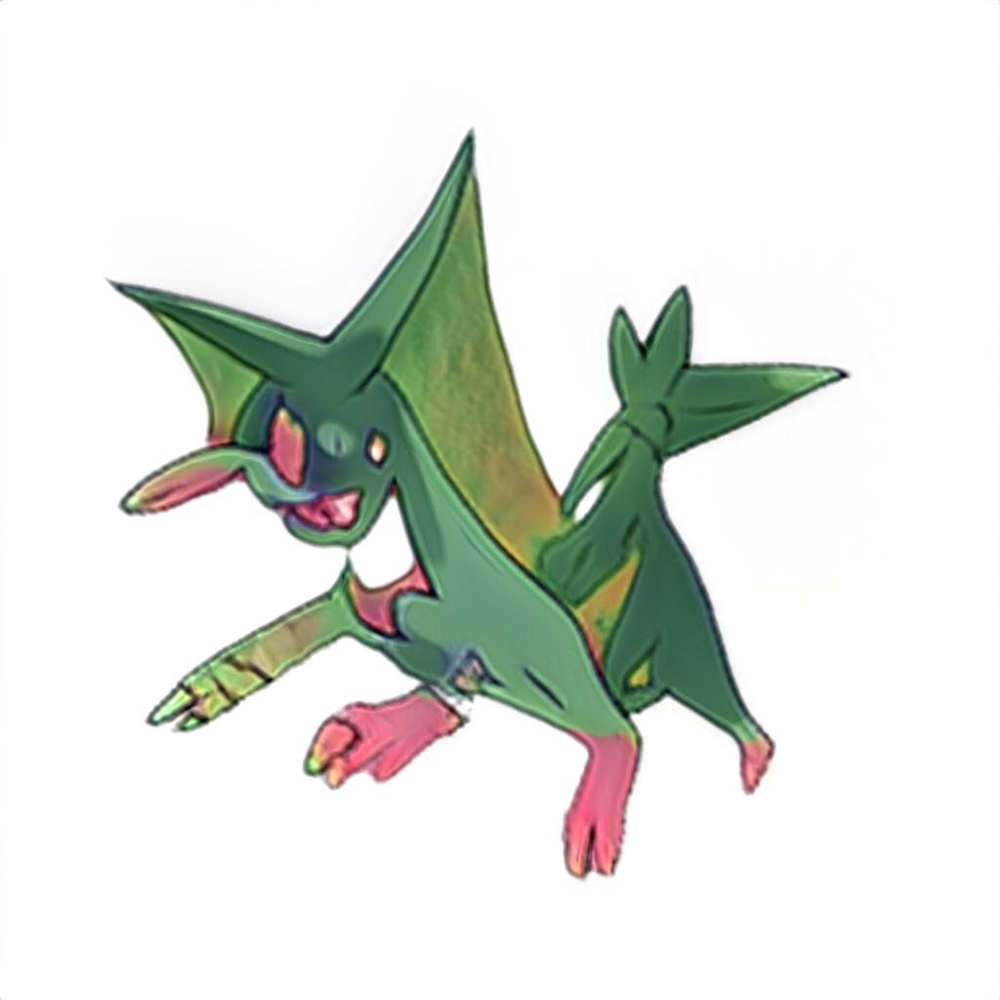

seed9429.png


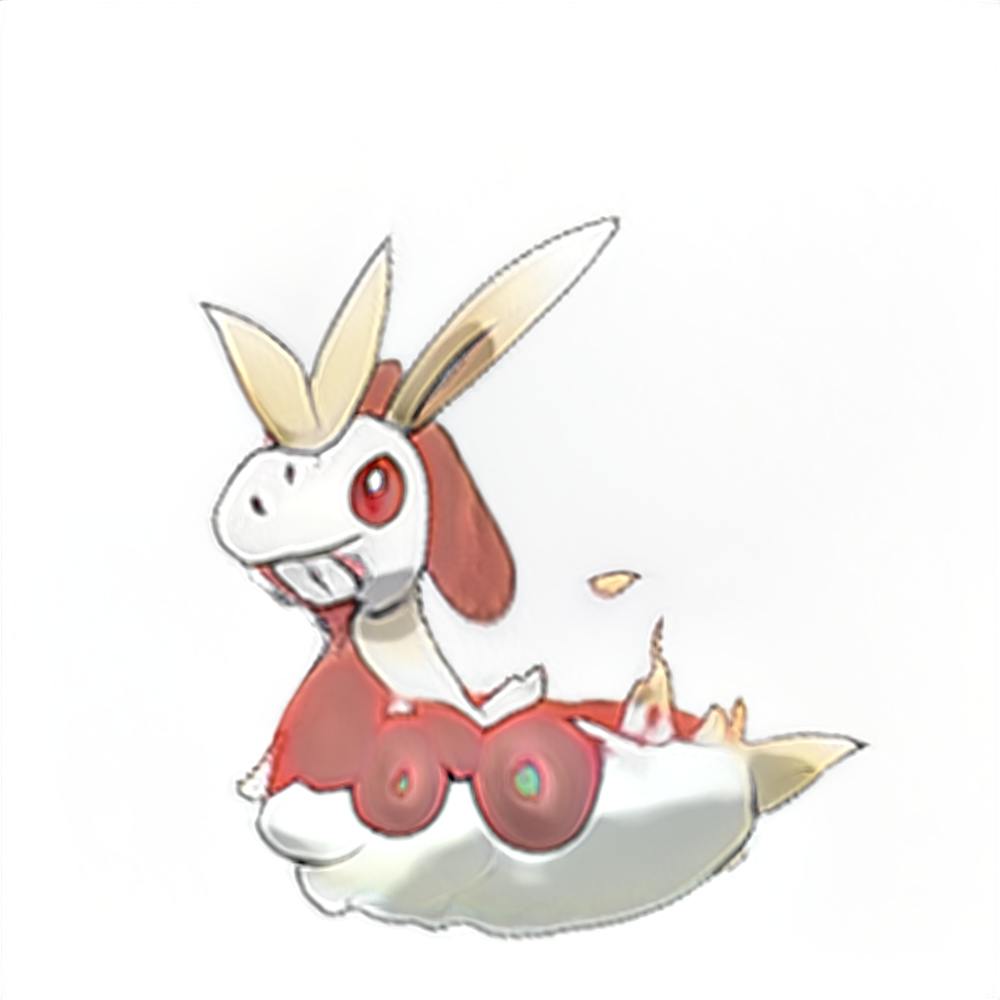

seed9462.png


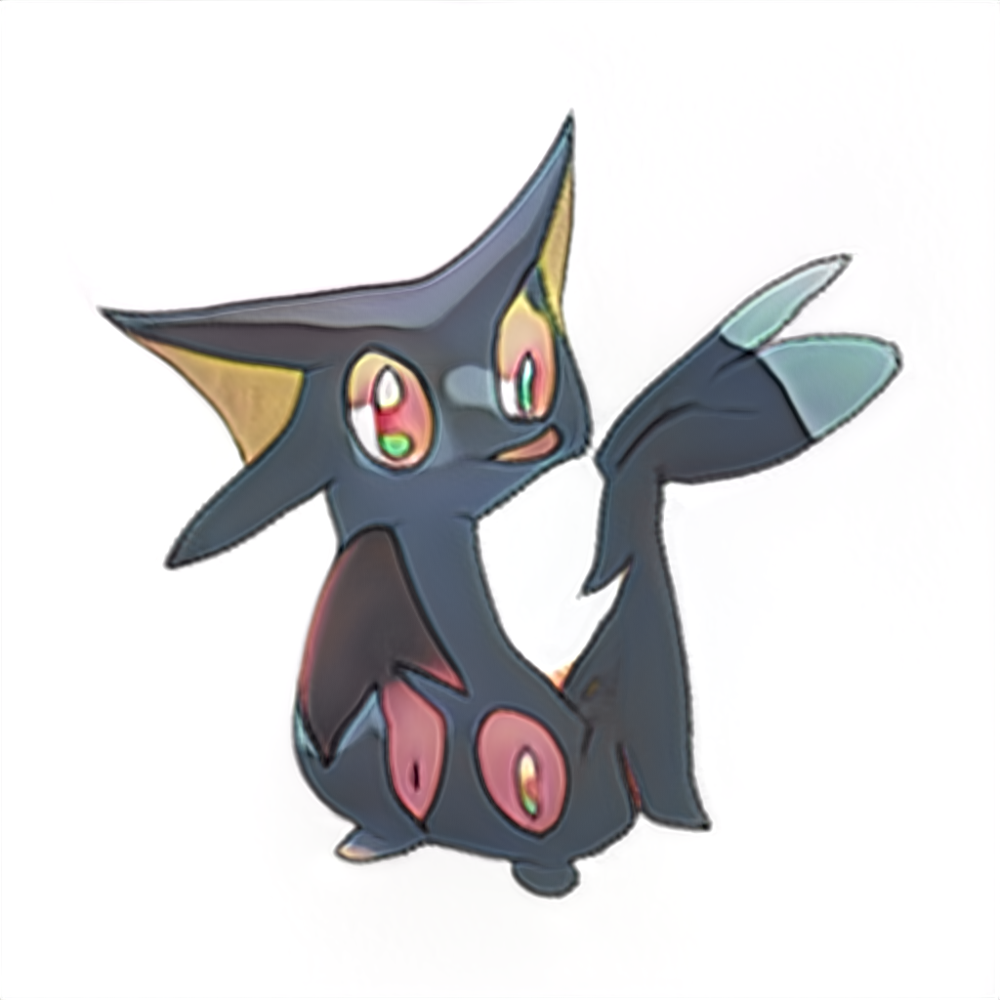

seed9482.png


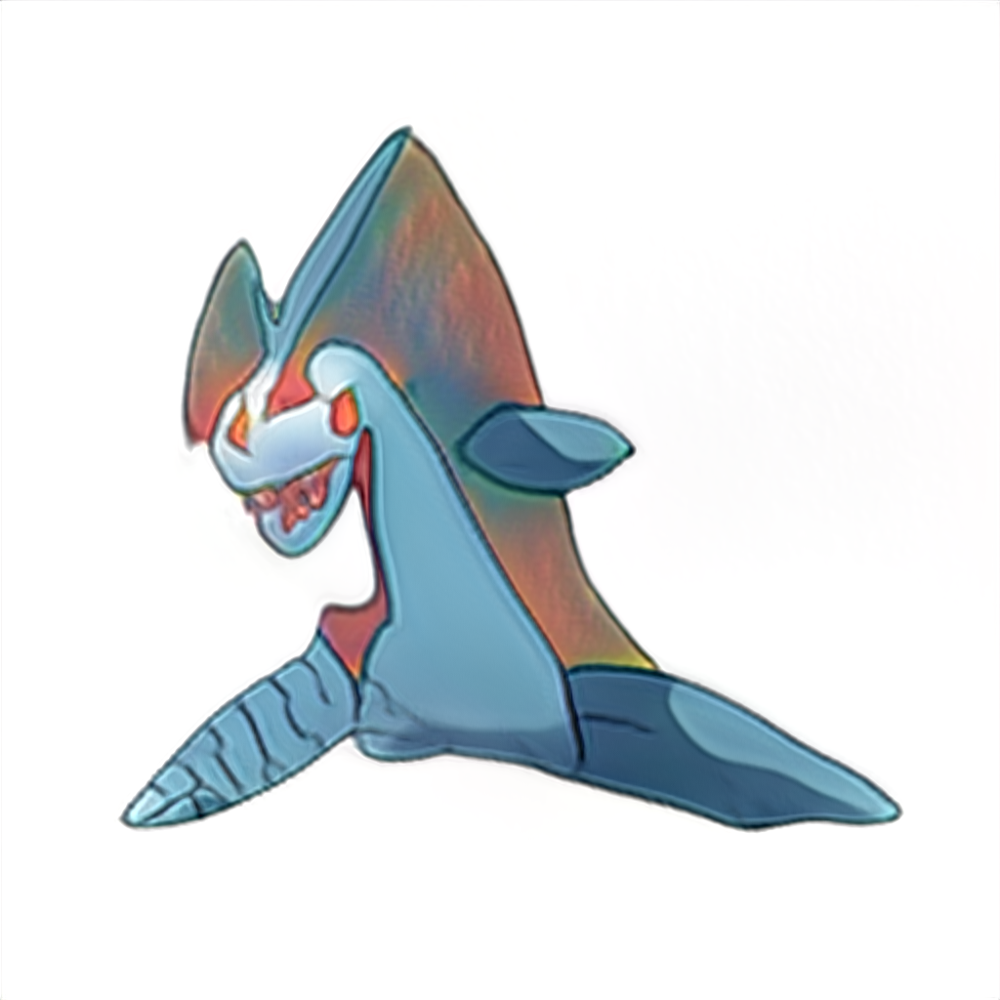

seed9535.png


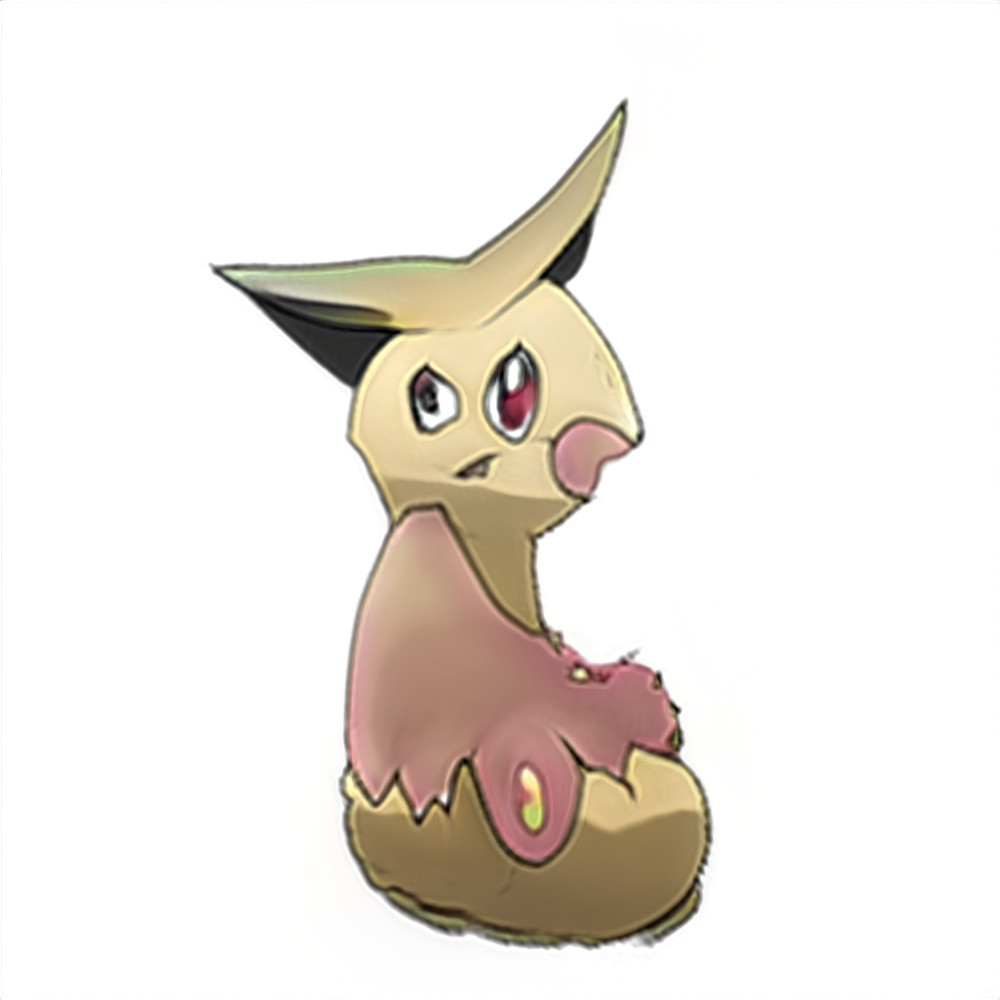

seed9604.png


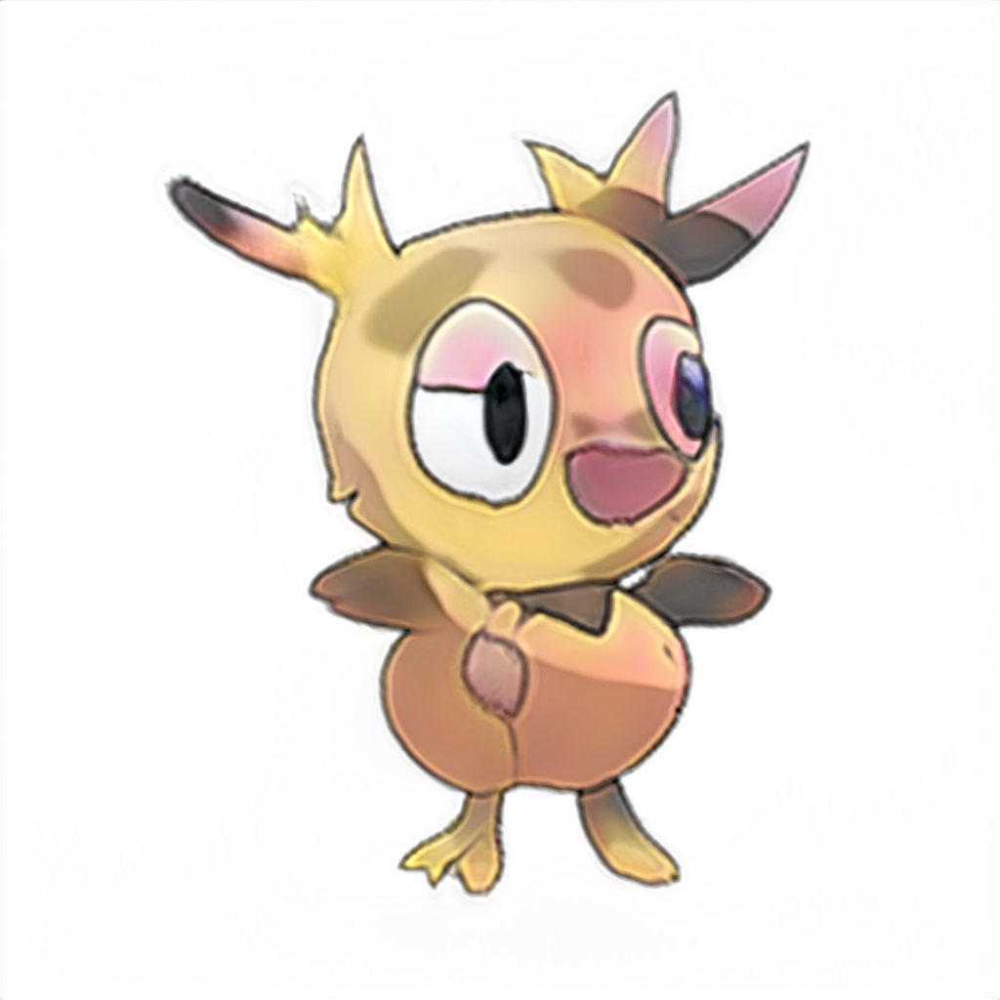

seed9628.png


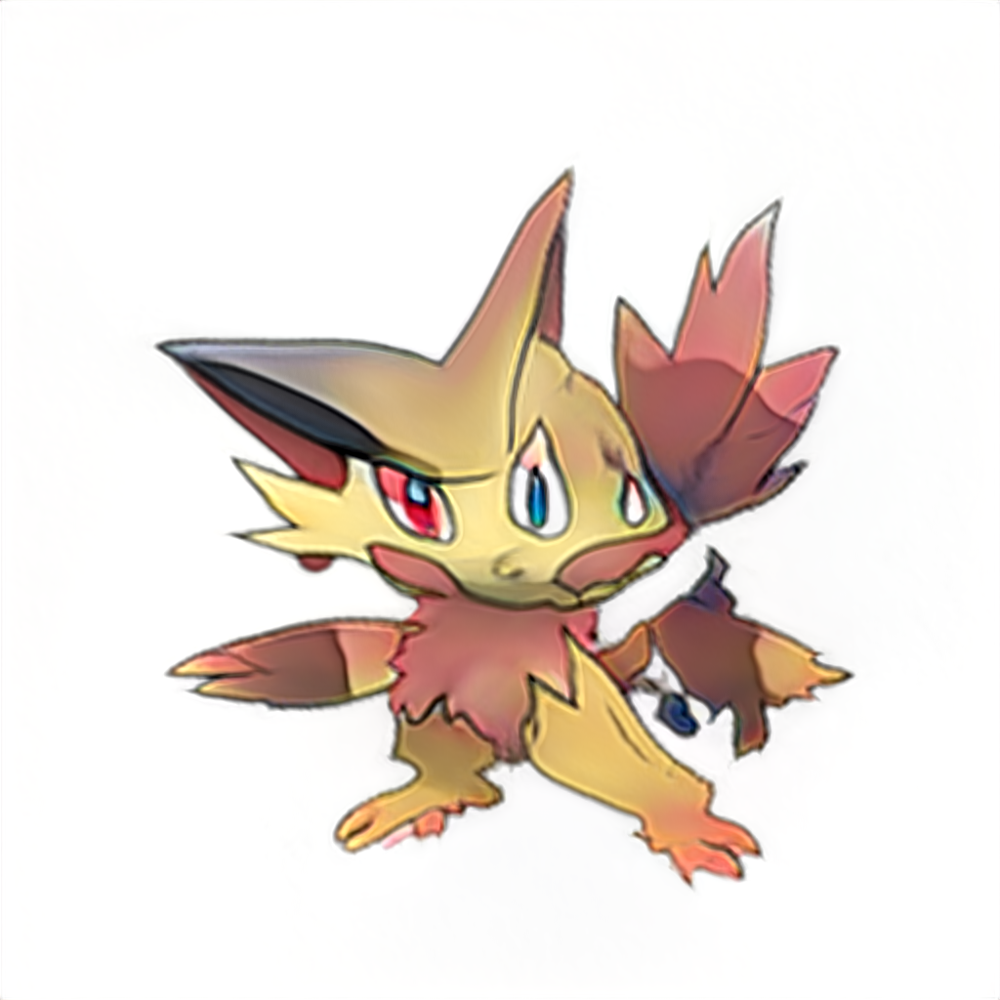

seed9669.png


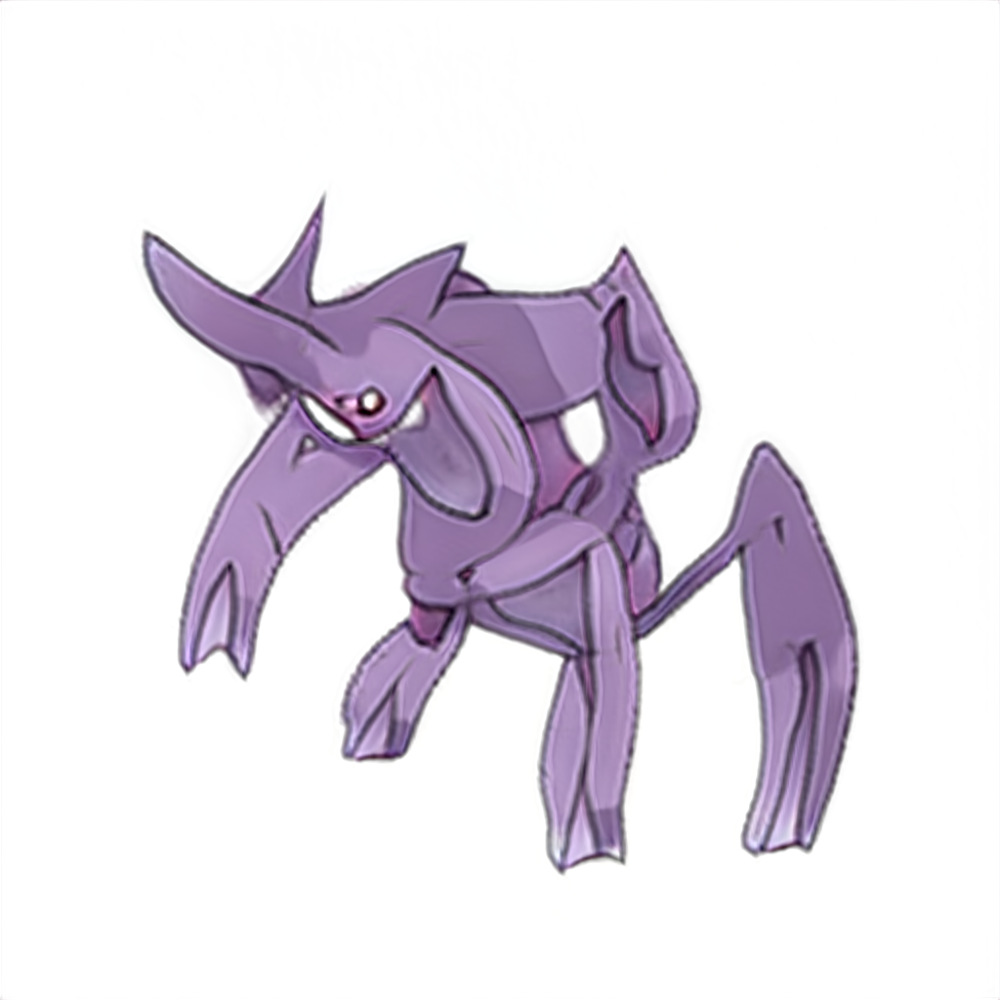

seed9722.png


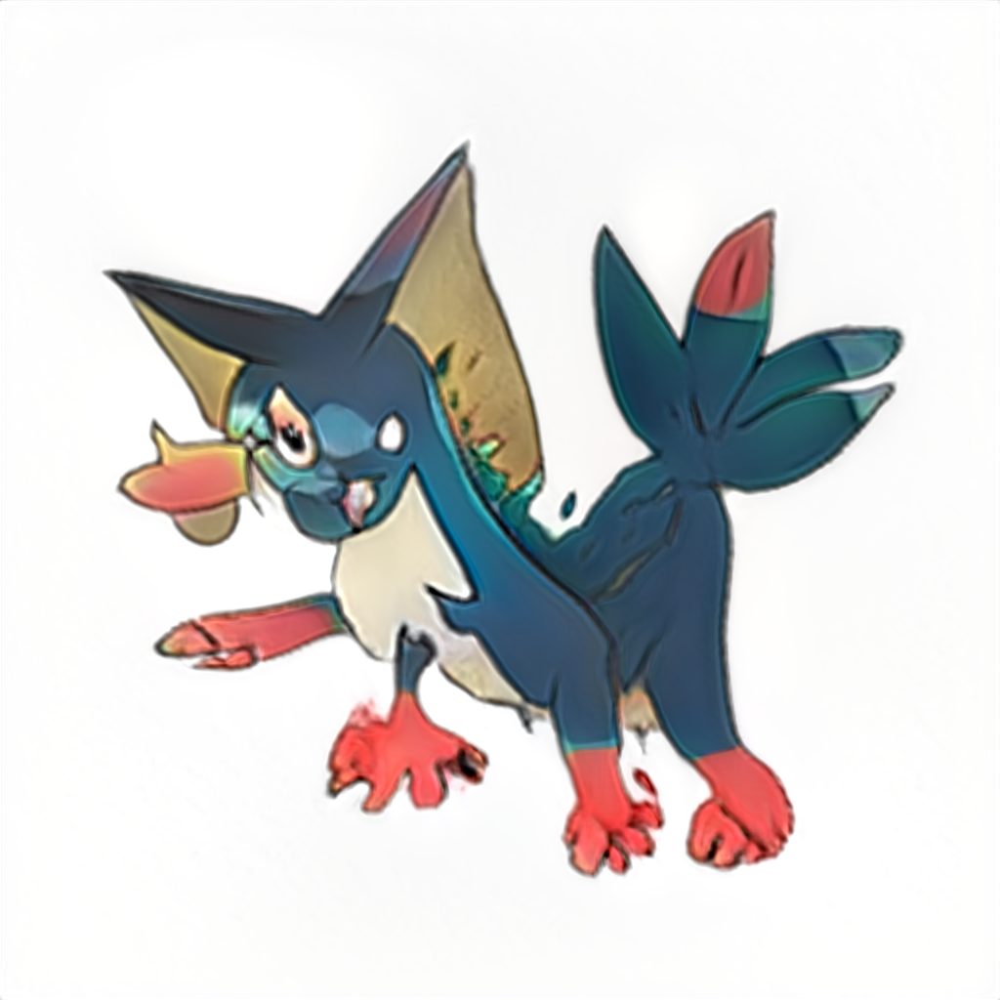

seed9725.png


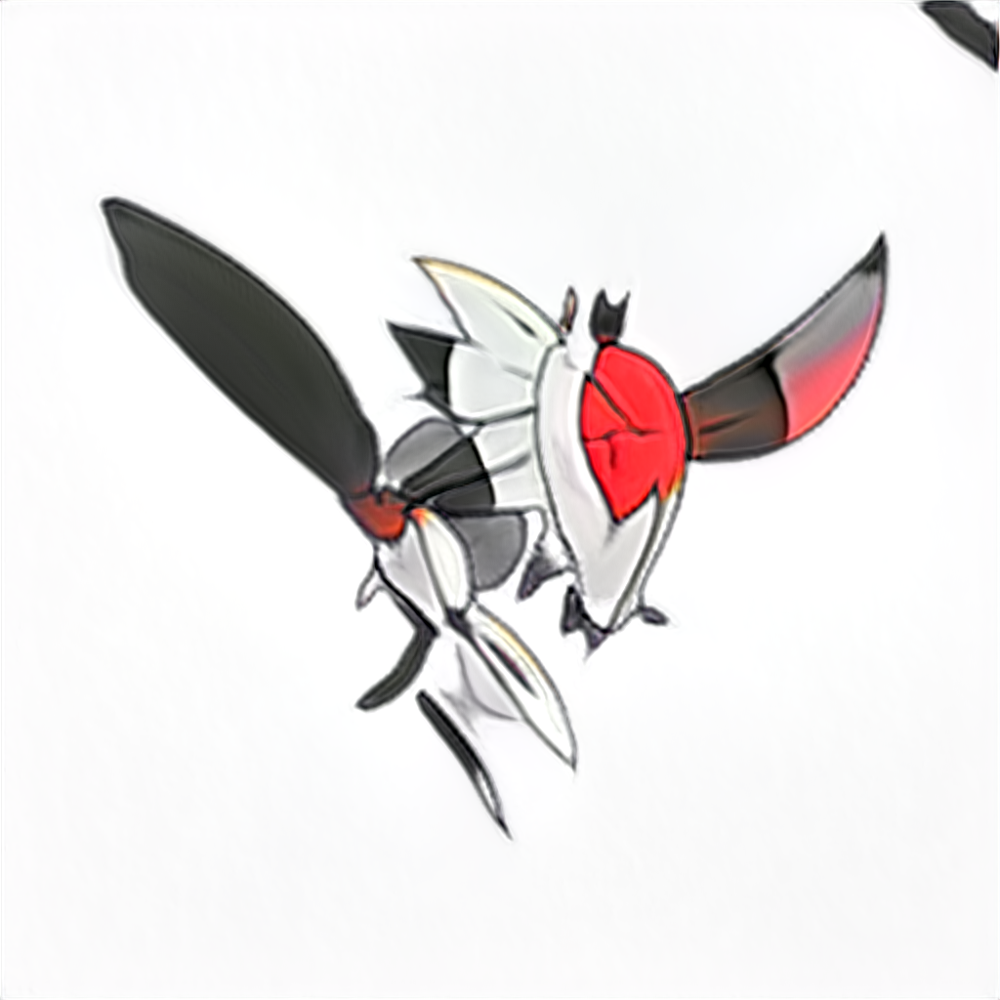

seed9753.png


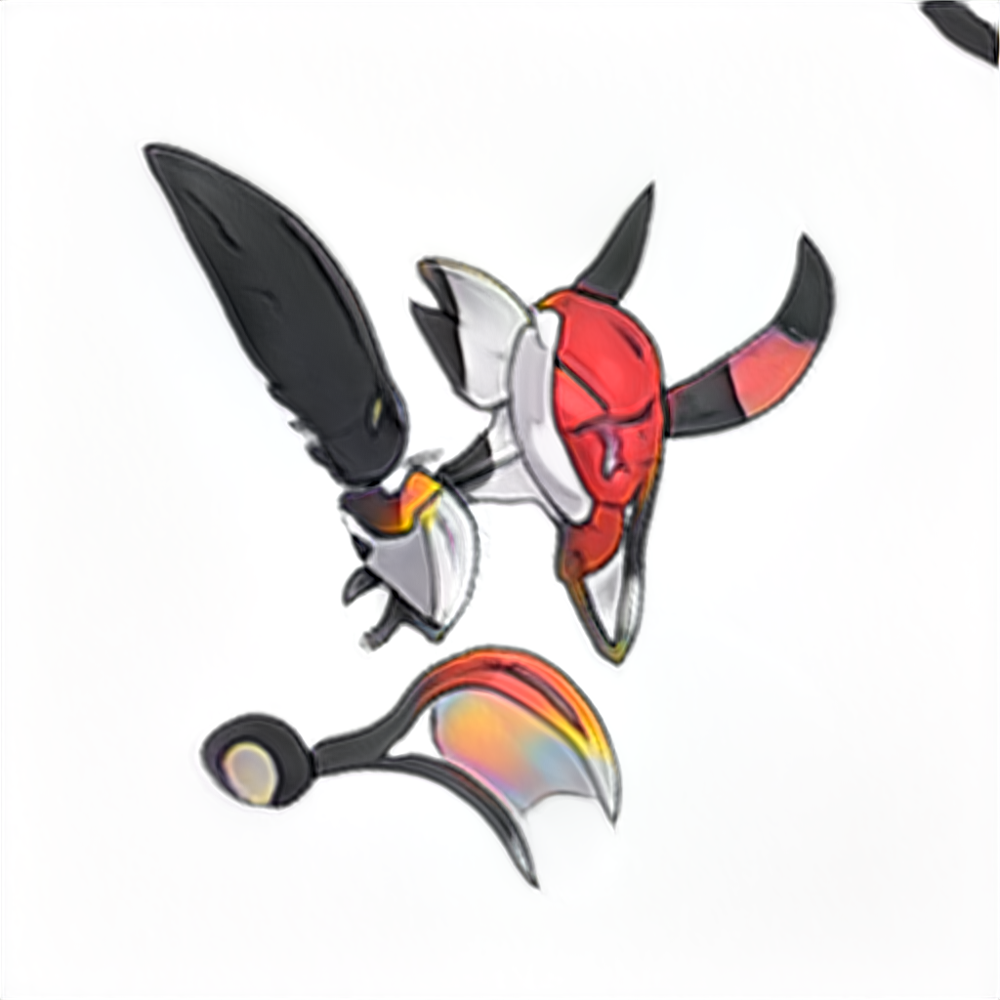

seed9794.png


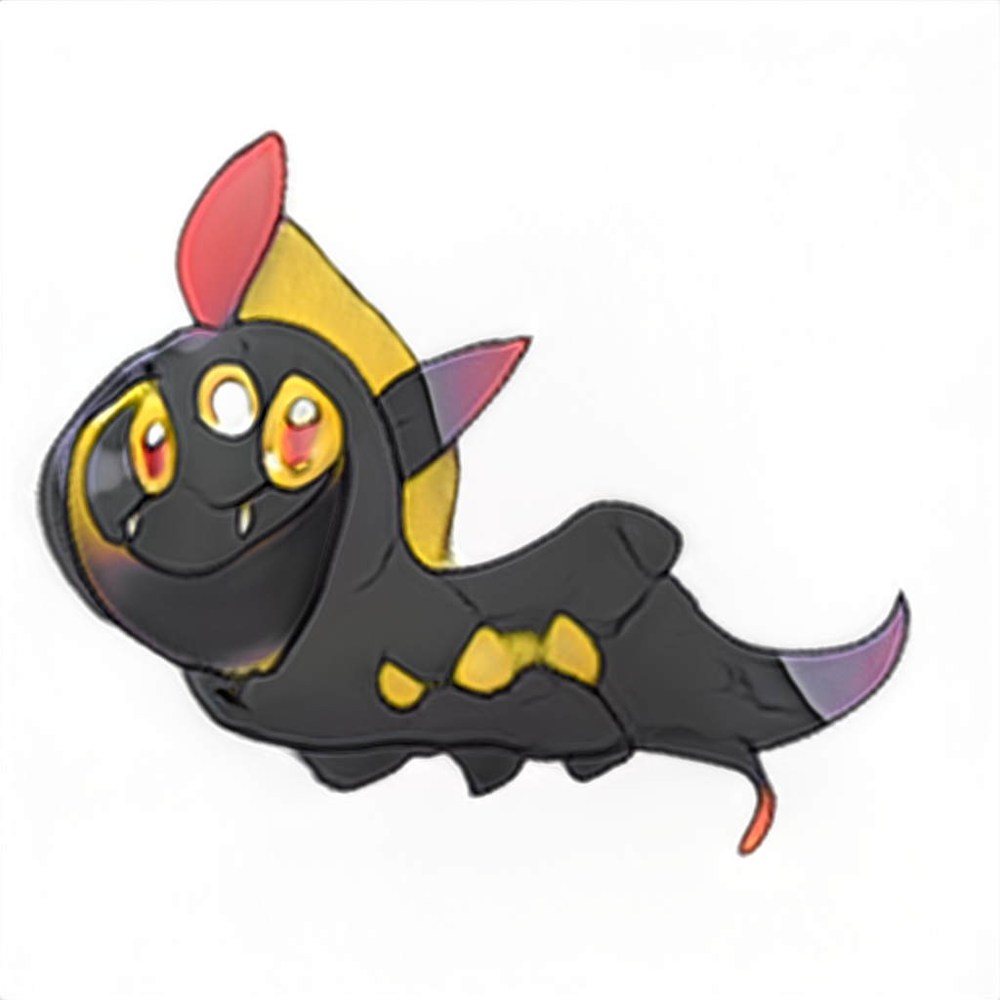

seed9858.png


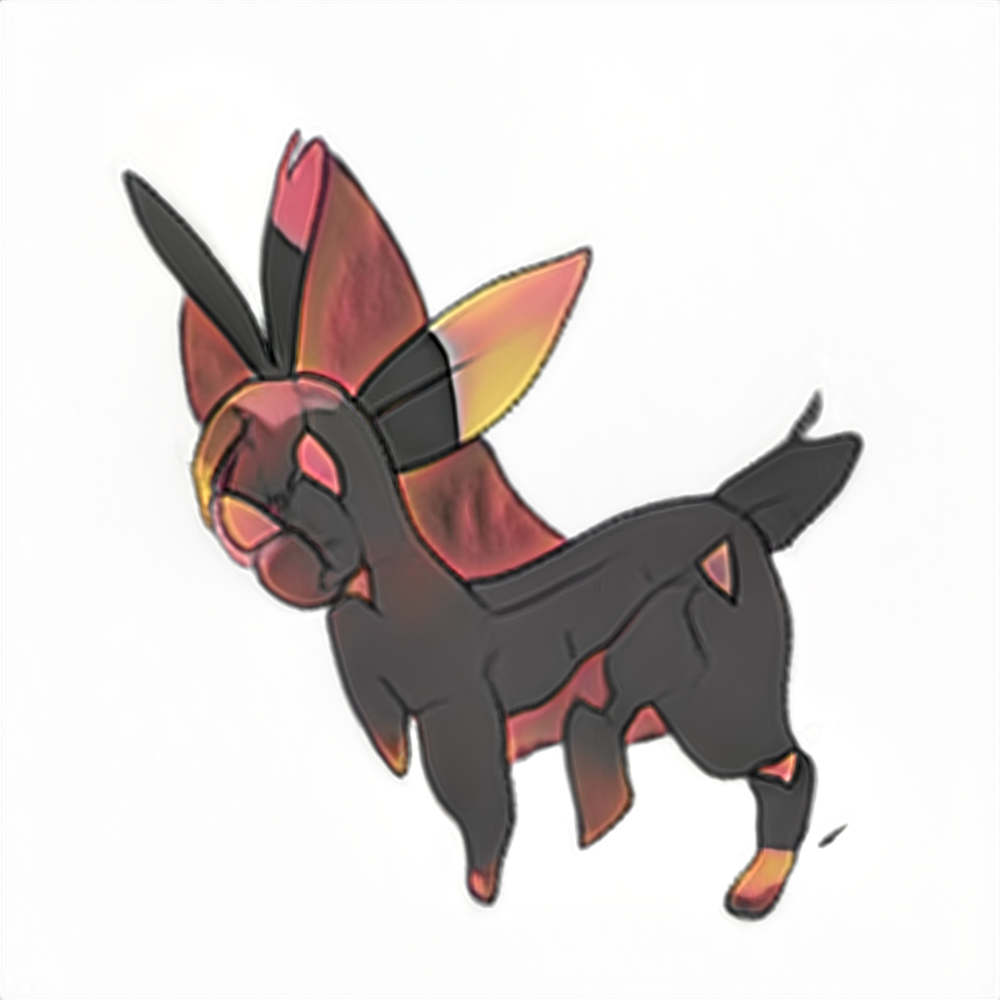

seed9903.png


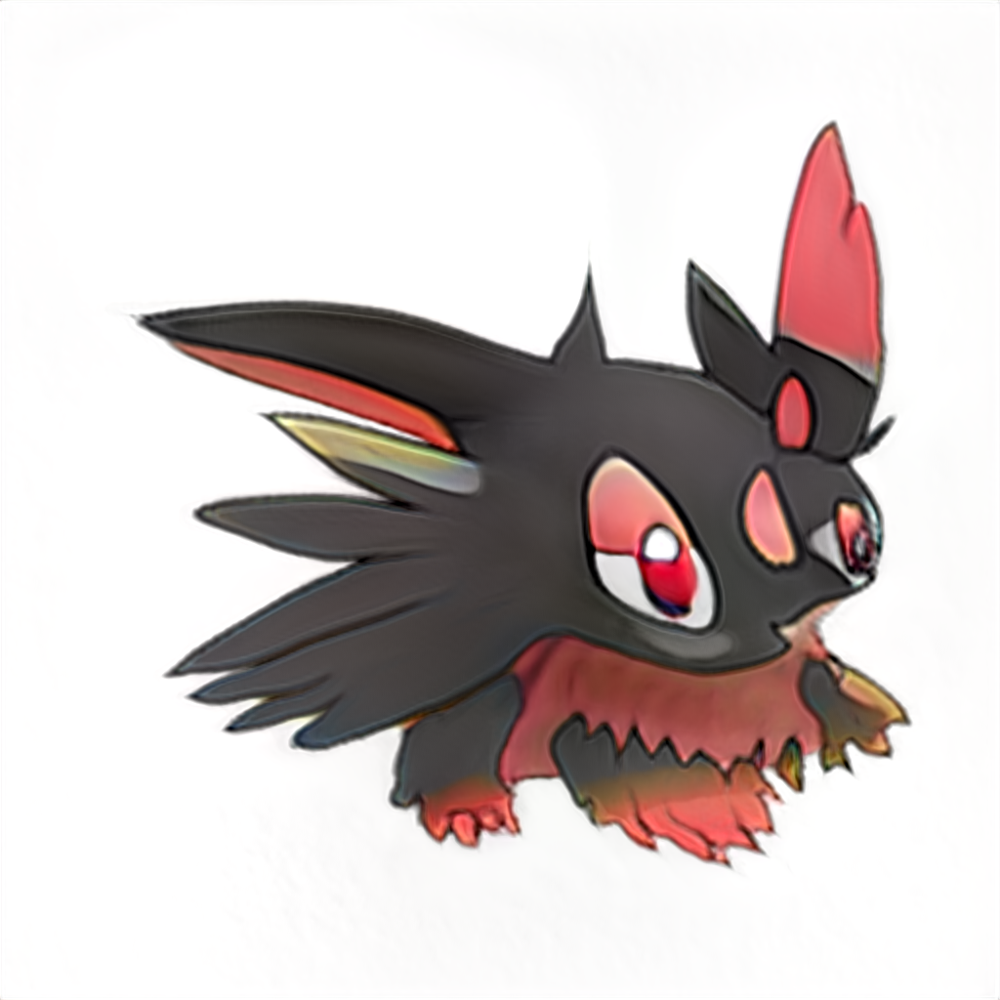

seed9923.png


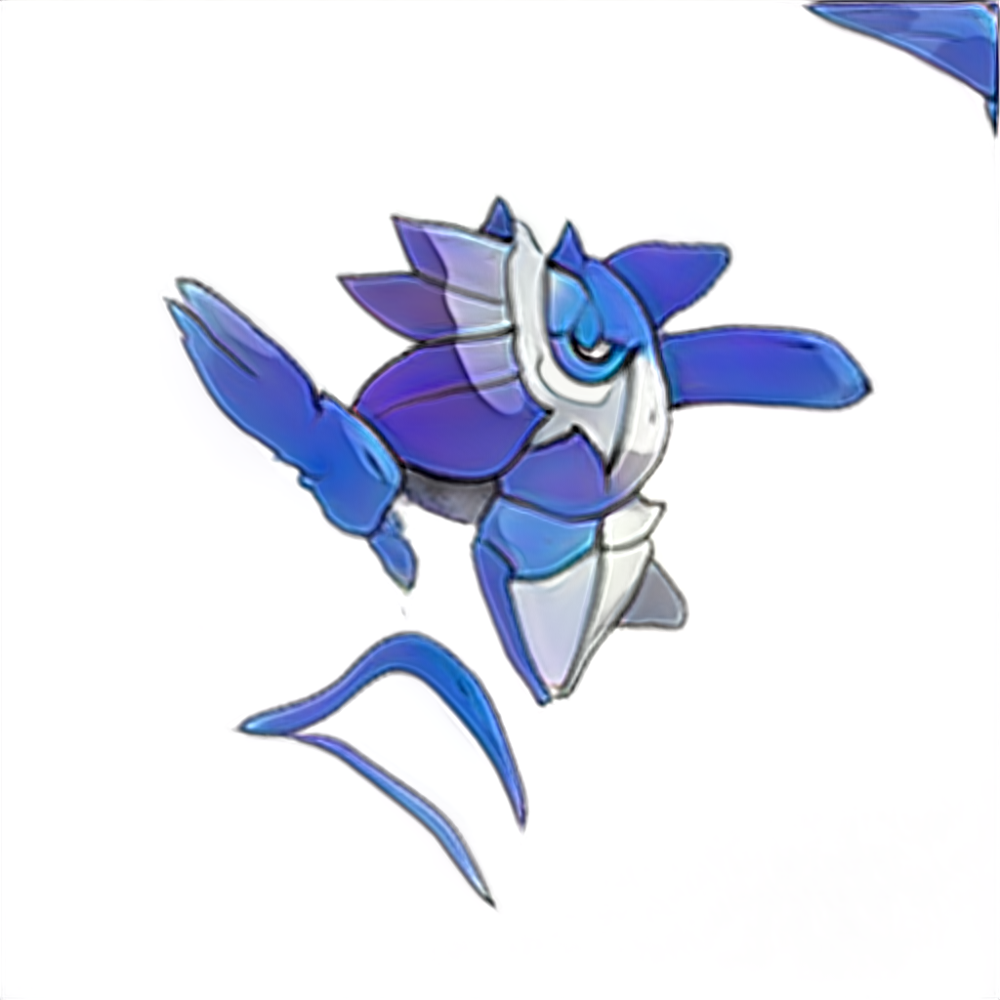

seed9937.png


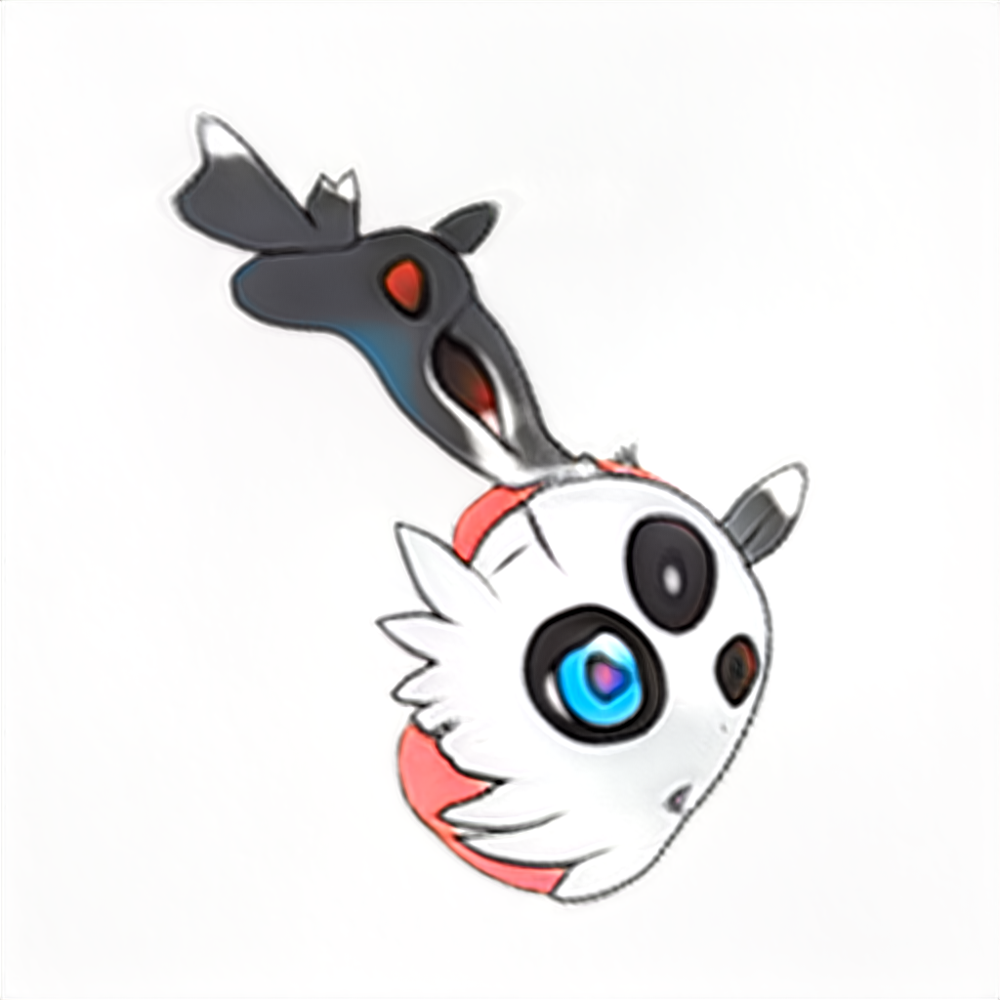

seed9938.png


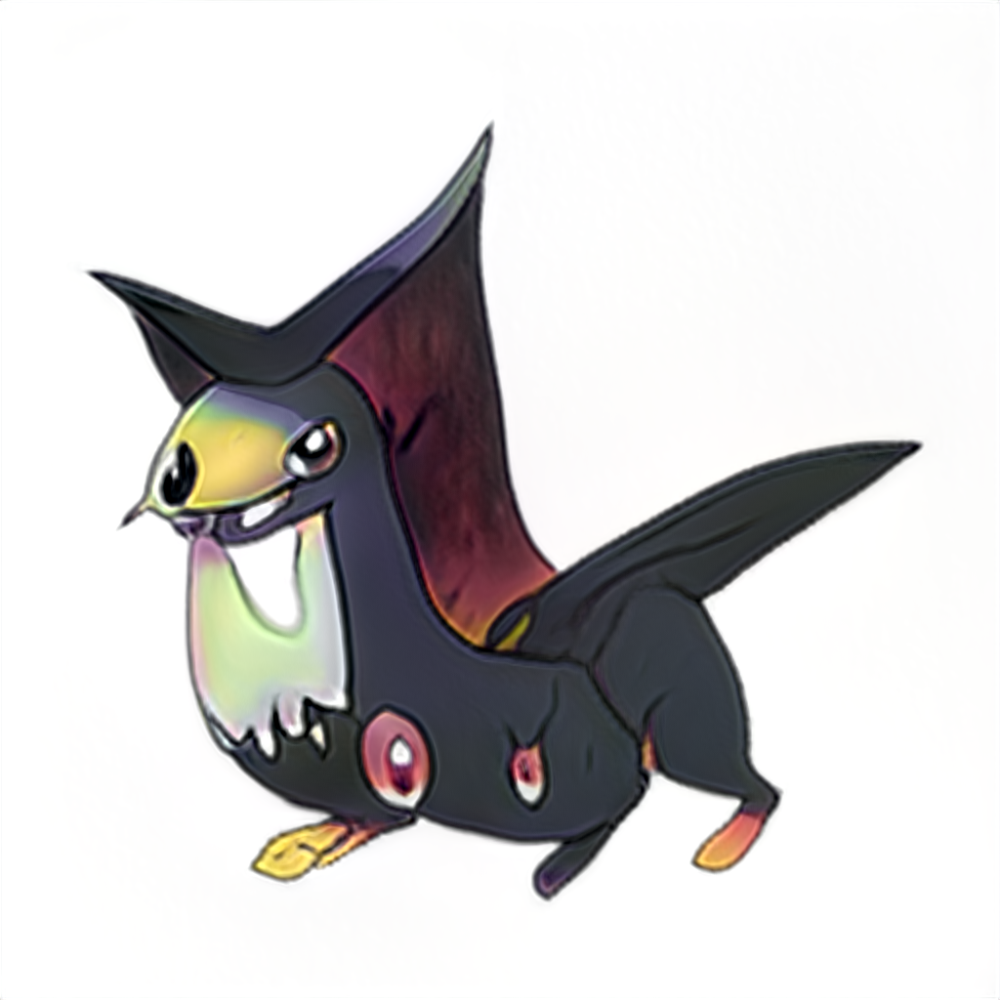

seed9992.png


In [ ]:
for a_image in groups[6]:
    display(Image(filename= "/content/drive/MyDrive/data/gan/output_images/" + a_image))
    print(a_image)

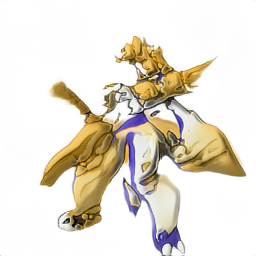

seed0002.png


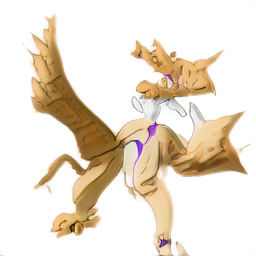

seed0010.png


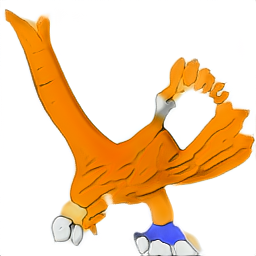

seed0018.png


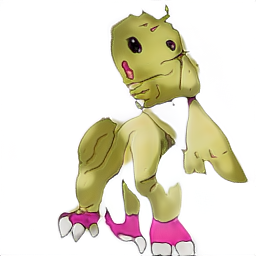

seed0034.png


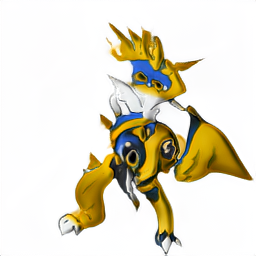

seed0068.png


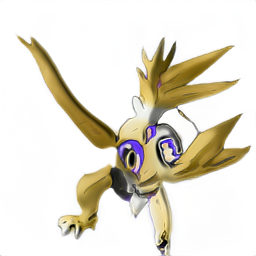

seed0099.png


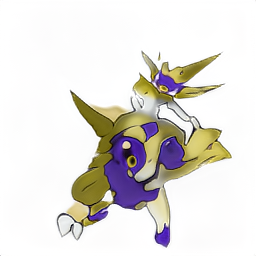

seed0110.png


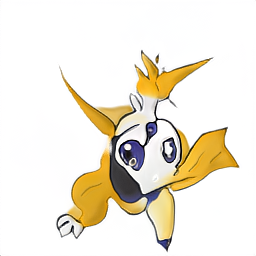

seed0117.png


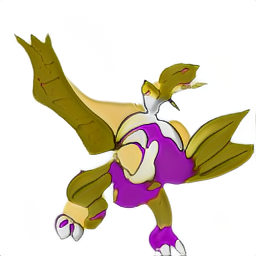

seed0162.png


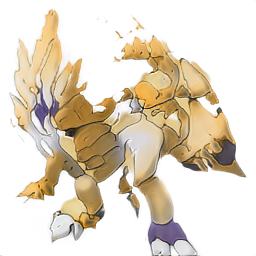

seed0171.png


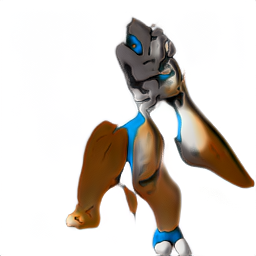

seed0173.png


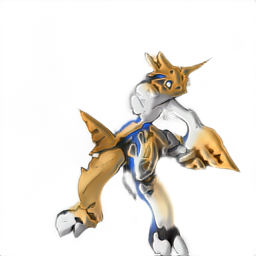

seed0190.png


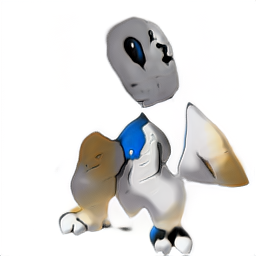

seed0193.png


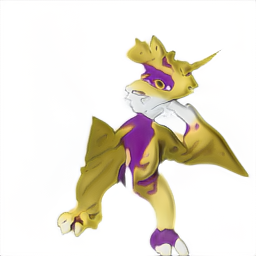

seed0194.png


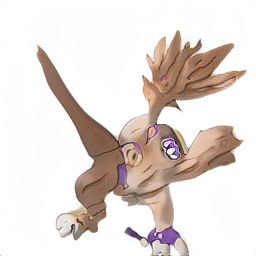

seed0195.png


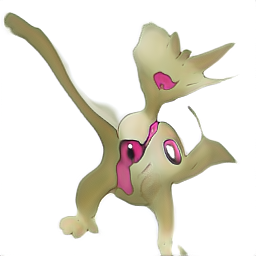

seed0203.png


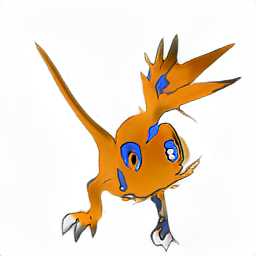

seed0247.png


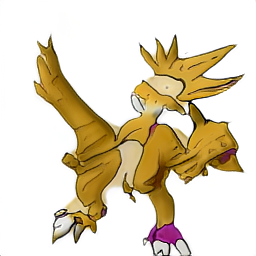

seed0278.png


In [ ]:
for a_image in groups[7]:
    display(Image(filename= "/content/drive/MyDrive/data/gan/output_images/" + a_image))
    print(a_image)